# This notebook analyses the VitalDB signal and some preprocessing techniques

In [1]:
import numpy as np
from PyEMD import EMD
from scipy.signal import periodogram
import os
import torch
import pandas as pd
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
from tqdm import tqdm
from models.ecg2ppg_model import ECG2PPGps, create_windows, ECG2PPGps_loss
from utils.eval_metrics import compute_dtw, compute_pearson, compute_rmse
from scipy.signal import butter, filtfilt
import vitaldb
import matplotlib.pyplot as plt
from scipy import sparse
from scipy.sparse.linalg import spsolve
from PyEMD import EMD
from scipy.signal import medfilt
import os
import numpy as np
import torch
import vitaldb
from torch.utils.data import DataLoader, TensorDataset
from scipy.signal import medfilt
import pywt



In [2]:
def remove_baseline_wander(signal, fs, cutoff=0.5, order=2):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return filtfilt(b, a, signal)


def normalize_signal(signal, method="minmax"):
    if method == "minmax":
        s_min, s_max = np.min(signal), np.max(signal)
        return (signal - s_min) / (s_max - s_min), s_min, s_max
    elif method == "zscore":
        mean, std = np.mean(signal), np.std(signal)
        return (signal - mean) / std, mean, std
    else:
        raise ValueError("method must be 'minmax' or 'zscore'")


def denormalize(signal_norm, method, stat1, stat2):
    if method == "minmax":
        return signal_norm * (stat2 - stat1) + stat1
    elif method == "zscore":
        return signal_norm * stat2 + stat1


def remove_baseline_median(signal, fs, window_sec=1.5):
    kernel_size = int(window_sec * fs)
    if kernel_size % 2 == 0:
        kernel_size += 1
    baseline = medfilt(signal, kernel_size=kernel_size)
    return signal - baseline


def remove_baseline_wavelet(signal, wavelet='db6', level=5):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    coeffs[0] = np.zeros_like(coeffs[0])  # zero out approximation (baseline)
    return pywt.waverec(coeffs, wavelet)[:len(signal)]  # trim in case of padding



In [6]:
fs = 500  # Hz
window_length = 5 * fs  # 5 seconds
min_minutes = 8
max_cases = 10

valid_cases = []
case_lengths = []

def load_and_clean_case(case_id, fs=500):
    vals = vitaldb.load_case(case_id, ['ECG_II', 'PLETH'], 1 / fs)
    ecg = vals[:, 0]
    ppg = vals[:, 1]
    valid = ~np.isnan(ecg) & ~np.isnan(ppg)
    return ecg[valid], ppg[valid]

print("🔍 Scanning for valid cases with ≥8 min ECG & PPG...")

for cid in range(1, 6389):
    try:
        ecg, ppg = load_and_clean_case(cid, fs)
        duration_min = len(ecg) / fs / 60

        if duration_min >= min_minutes:
            valid_cases.append((cid, ecg, ppg))
            case_lengths.append((cid, duration_min))
            print(f"✅ Case {cid} valid: {duration_min:.1f} min")

        if len(valid_cases) >= max_cases:
            break

    except Exception as e:
        print(f"⚠️ Case {cid} skipped: {e}")


🔍 Scanning for valid cases with ≥8 min ECG & PPG...
✅ Case 1 valid: 192.3 min
✅ Case 2 valid: 262.3 min
✅ Case 3 valid: 72.9 min
✅ Case 4 valid: 349.5 min
✅ Case 5 valid: 358.8 min
✅ Case 6 valid: 85.7 min
✅ Case 7 valid: 262.6 min
✅ Case 8 valid: 98.6 min
✅ Case 9 valid: 74.7 min
✅ Case 10 valid: 349.8 min


In [7]:
df = pd.DataFrame(case_lengths, columns=["CaseID", "Length_minutes"])
df = df.sort_values(by="Length_minutes", ascending=False).reset_index(drop=True)
print("📋 Valid Cases (≥8 minutes):")
display(df)


📋 Valid Cases (≥8 minutes):


,CaseID,Length_minutes
0,5,358.828833
1,10,349.802433
2,4,349.504167
3,7,262.566733
4,2,262.323067
5,1,192.337633
6,8,98.606533
7,6,85.715367
8,9,74.659933
9,3,72.932033


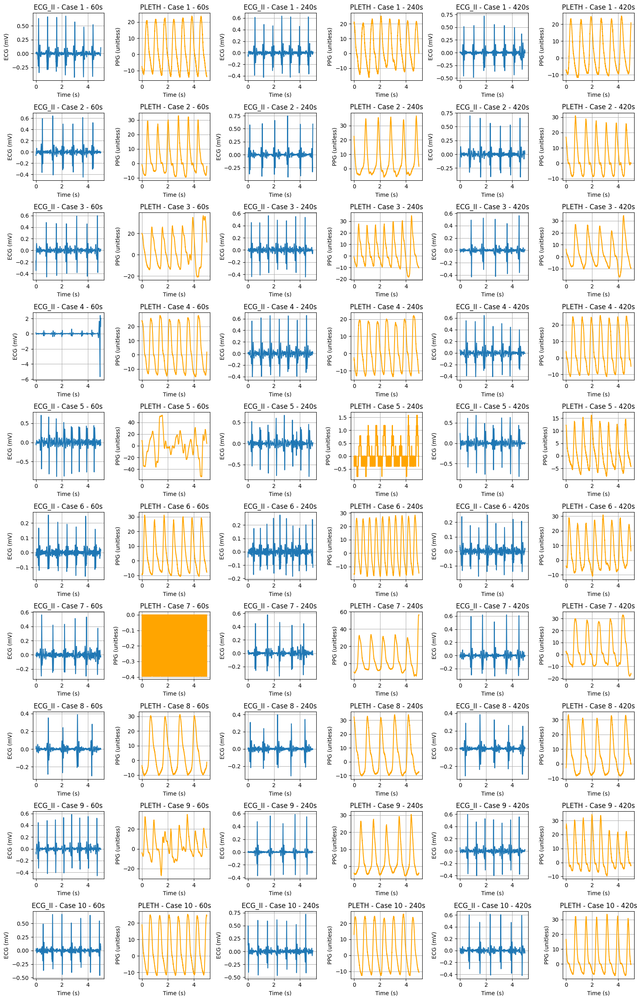

In [8]:
# Apply baseline removal to full signal before windowing
fs = 500
num_windows = 3
window_offsets_sec = [60, 240, 420]
window_samples = 5 * fs  # 5 seconds

fig, axs = plt.subplots(len(valid_cases), num_windows * 2, figsize=(16, 2.5 * len(valid_cases)))

for i, (cid, ecg_raw, ppg_raw) in enumerate(valid_cases):
    # --- Apply baseline correction to full signals ---
    ecg = remove_baseline_wavelet(ecg_raw)
    ppg = remove_baseline_median(ppg_raw, fs, window_sec=1.5)

    for j, offset_sec in enumerate(window_offsets_sec):
        start = int(offset_sec * fs)
        end = start + window_samples
        if end > len(ecg) or end > len(ppg):
            continue

        t = np.arange(window_samples) / fs

        # ECG plot
        axs[i, j*2].plot(t, ecg[start:end])
        axs[i, j*2].set_title(f"ECG_II - Case {cid} - {offset_sec}s")
        axs[i, j*2].set_ylabel("ECG (mV)")
        axs[i, j*2].grid()

        # PPG plot
        axs[i, j*2+1].plot(t, ppg[start:end], color='orange')
        axs[i, j*2+1].set_title(f"PLETH - Case {cid} - {offset_sec}s")
        axs[i, j*2+1].set_ylabel("PPG (unitless)")
        axs[i, j*2+1].grid()

for ax in axs.flat:
    ax.set_xlabel("Time (s)")

plt.tight_layout()
plt.show()


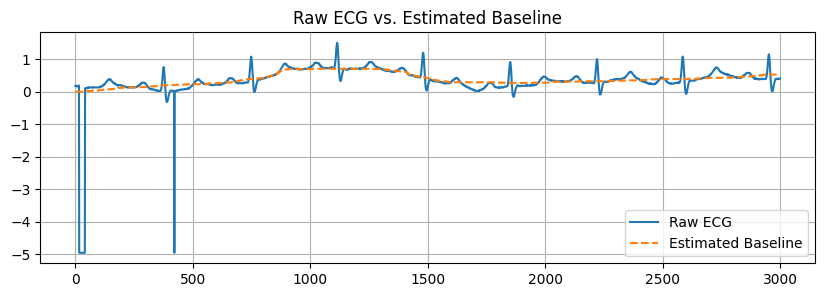

In [9]:
baseline = medfilt(ecg_raw, kernel_size=751)
plt.figure(figsize=(10, 3))
plt.plot(ecg_raw[:3000], label="Raw ECG")
plt.plot(baseline[:3000], label="Estimated Baseline", linestyle="--")
plt.legend()
plt.title("Raw ECG vs. Estimated Baseline")
plt.grid()
plt.show()


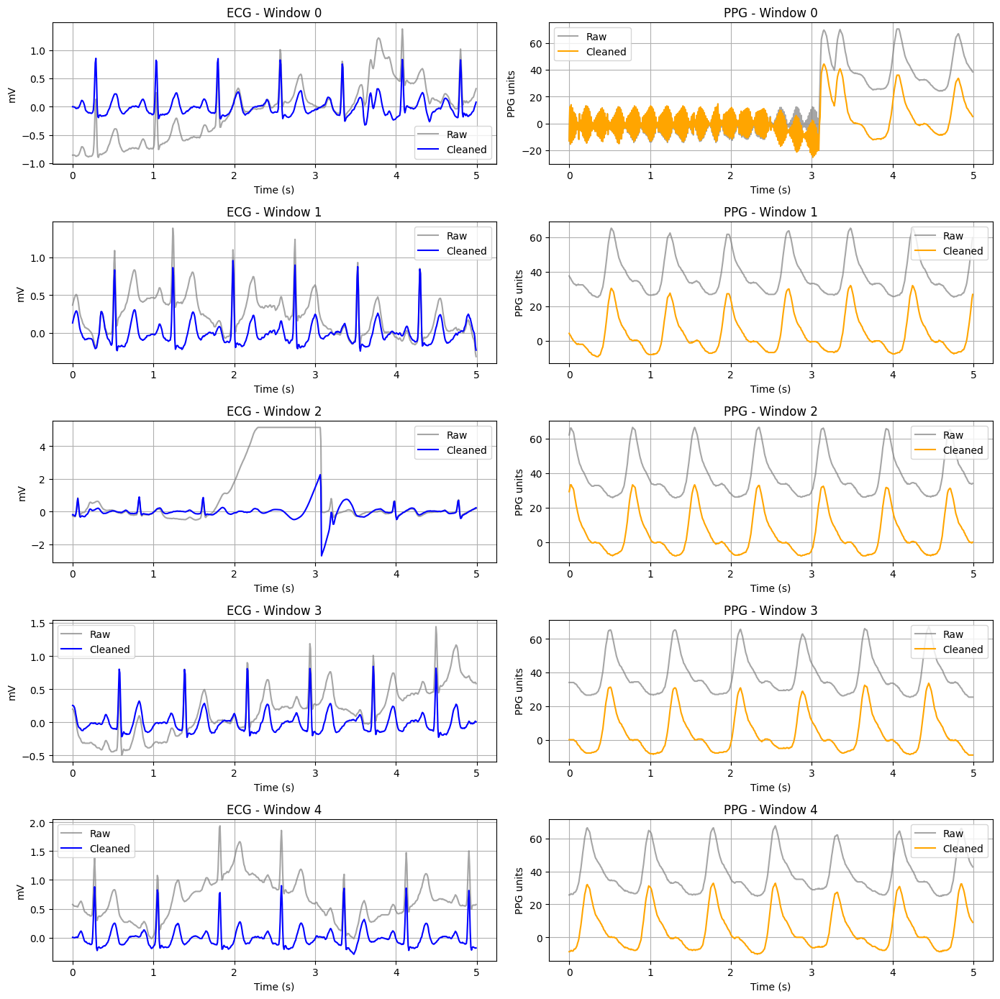

In [30]:
import vitaldb
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import medfilt

# --- Preprocessing ---
def remove_baseline_median(signal, fs, window_sec=1.5):
    kernel_size = int(window_sec * fs)
    if kernel_size % 2 == 0:
        kernel_size += 1
    return signal - medfilt(signal, kernel_size=kernel_size)

# --- Windowing ---
def create_windows(signal, window_length, stride):
    return np.array([signal[i:i + window_length] 
                     for i in range(0, len(signal) - window_length + 1, stride)])


def remove_baseline_wavelet(signal, wavelet='db6', level=5):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    baseline = pywt.waverec([coeffs[0]] + [np.zeros_like(c) for c in coeffs[1:]], wavelet)
    cleaned = pywt.waverec([np.zeros_like(coeffs[0])] + coeffs[1:], wavelet)
    return cleaned[:len(signal)], baseline[:len(signal)]


# --- Parameters ---
fs_raw = 500
fs_target = 125
window_len = 5 * fs_target  # 5 seconds
stride = window_len
start_offset_sec = 1
start_idx_raw = fs_raw * start_offset_sec
downsample_factor = fs_raw // fs_target

# --- Load case 1 ---
vals = vitaldb.load_case(2, ['ECG_II', 'PLETH'], 1 / fs_raw)
ecg_raw_all, ppg_raw_all = vals[:, 0], vals[:, 1]

# --- Clean NaNs ---
mask = ~np.isnan(ecg_raw_all) & ~np.isnan(ppg_raw_all)
ecg_raw_all = ecg_raw_all[mask]
ppg_raw_all = ppg_raw_all[mask]

# --- Raw window (before cleaning) ---
ecg_raw = ecg_raw_all[start_idx_raw::downsample_factor]
ppg_raw = ppg_raw_all[start_idx_raw::downsample_factor]

# --- Cleaned ---
ecg_clean = remove_baseline_wavelet(ecg_raw)
ppg_clean = remove_baseline_median(ppg_raw, fs=125, window_sec=1.5)

# --- Windowed ---
ecg_raw_windows = create_windows(ecg_raw, window_len, stride)
ppg_raw_windows = create_windows(ppg_raw, window_len, stride)
ecg_clean_windows = create_windows(ecg_clean, window_len, stride)
ppg_clean_windows = create_windows(ppg_clean, window_len, stride)

# --- Plot N windows ---
N = 5
fig, axs = plt.subplots(N, 2, figsize=(14, 2.8 * N))

for i in range(N):
    t = np.arange(window_len) / fs_target

    # ECG
    axs[i, 0].plot(t, ecg_raw_windows[i], label="Raw", color='gray', alpha=0.7)
    axs[i, 0].plot(t, ecg_clean_windows[i], label="Cleaned", color='blue')
    axs[i, 0].set_title(f"ECG - Window {i}")
    axs[i, 0].set_ylabel("mV")
    axs[i, 0].grid()
    axs[i, 0].legend()

    # PPG
    axs[i, 1].plot(t, ppg_raw_windows[i], label="Raw", color='gray', alpha=0.7)
    axs[i, 1].plot(t, ppg_clean_windows[i], label="Cleaned", color='orange')
    axs[i, 1].set_title(f"PPG - Window {i}")
    axs[i, 1].set_ylabel("PPG units")
    axs[i, 1].grid()
    axs[i, 1].legend()

for ax in axs.flat:
    ax.set_xlabel("Time (s)")

plt.tight_layout()
plt.show()


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import vitaldb
from scipy.signal import periodogram, medfilt
import pywt

# --- Helper Functions ---

def remove_baseline_wavelet(signal, wavelet='db6', level=5):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    coeffs[0] = np.zeros_like(coeffs[0])
    return pywt.waverec(coeffs, wavelet)[:len(signal)]

def remove_baseline_median(signal, fs, window_sec=1.5):
    kernel_size = int(window_sec * fs)
    if kernel_size % 2 == 0:
        kernel_size += 1
    baseline = medfilt(signal, kernel_size=kernel_size)
    return signal - baseline

def compute_signal_quality(signal, fs):
    quality_metrics = {}

    # Missing Data Ratio
    missing_ratio = np.isnan(signal).sum() / len(signal)
    quality_metrics['missing_ratio'] = missing_ratio

    # Amplitude Range
    amp_range = np.max(signal) - np.min(signal)
    quality_metrics['amplitude_range'] = amp_range

    # Low Frequency Power Ratio
    f, Pxx = periodogram(signal, fs)
    power_low = np.sum(Pxx[f < 0.5])
    power_total = np.sum(Pxx)
    if power_total > 0:
        low_freq_ratio = power_low / power_total
    else:
        low_freq_ratio = 0
    quality_metrics['low_freq_ratio'] = low_freq_ratio

    return quality_metrics

# --- Parameters ---

fs = 500  # Hz
cases_to_analyze = [i for i in range(1, 61) if i not in [12, 53]]

results = []

print(f"🔍 Analyzing cases 1-60 (excluding 12 & 53)...")

for cid in cases_to_analyze:
    try:
        vals = vitaldb.load_case(cid, ['ECG_II', 'PLETH'], 1/fs)
        ecg = vals[:, 0]
        ppg = vals[:, 1]
        valid = ~np.isnan(ecg) & ~np.isnan(ppg)
        ecg = ecg[valid]
        ppg = ppg[valid]

        if len(ecg) < fs * 60:  # Skip cases shorter than 1 minute
            print(f"⚠️ Case {cid} skipped: too short ({len(ecg)/fs:.1f} sec).")
            continue

        # Baseline Removal
        ecg_clean = remove_baseline_wavelet(ecg)
        ppg_clean = remove_baseline_median(ppg, fs)

        # Quality Metrics
        ecg_metrics = compute_signal_quality(ecg_clean, fs)
        ppg_metrics = compute_signal_quality(ppg_clean, fs)

        # Store results
        results.append({
            'CaseID': cid,
            'Length_min': len(ecg) / fs / 60,
            'ECG_missing_ratio': ecg_metrics['missing_ratio'],
            'ECG_amplitude_range': ecg_metrics['amplitude_range'],
            'ECG_low_freq_ratio': ecg_metrics['low_freq_ratio'],
            'PPG_missing_ratio': ppg_metrics['missing_ratio'],
            'PPG_amplitude_range': ppg_metrics['amplitude_range'],
            'PPG_low_freq_ratio': ppg_metrics['low_freq_ratio']
        })

        print(f"✅ Case {cid} processed: {len(ecg)/fs/60:.1f} min")

    except Exception as e:
        print(f"⚠️ Case {cid} skipped: {e}")

# --- Results Summary ---

df_results = pd.DataFrame(results)
df_results = df_results.sort_values(by='Length_min', ascending=False).reset_index(drop=True)

print("\n📊 Summary of Signal Quality Metrics:")
print(df_results)

# Optional: Display the DataFrame nicely (works in Jupyter)
from IPython.display import display
display(df_results)


🔍 Analyzing cases 1-60 (excluding 12 & 53)...
✅ Case 1 processed: 192.3 min
✅ Case 2 processed: 262.3 min
✅ Case 3 processed: 72.9 min
✅ Case 4 processed: 349.5 min
✅ Case 5 processed: 358.8 min
✅ Case 6 processed: 85.7 min
✅ Case 7 processed: 262.6 min
✅ Case 8 processed: 98.6 min
✅ Case 9 processed: 74.7 min
✅ Case 10 processed: 349.8 min
✅ Case 11 processed: 87.7 min
✅ Case 13 processed: 179.6 min
✅ Case 14 processed: 68.5 min
✅ Case 15 processed: 58.2 min
✅ Case 16 processed: 214.4 min
✅ Case 17 processed: 339.5 min
✅ Case 18 processed: 73.3 min
✅ Case 19 processed: 459.5 min
✅ Case 20 processed: 441.2 min
✅ Case 21 processed: 207.4 min
✅ Case 22 processed: 239.5 min
✅ Case 23 processed: 47.1 min
✅ Case 24 processed: 108.1 min
✅ Case 25 processed: 246.9 min
✅ Case 26 processed: 178.2 min
✅ Case 27 processed: 297.8 min
✅ Case 28 processed: 447.8 min
✅ Case 29 processed: 356.2 min
✅ Case 30 processed: 185.4 min
✅ Case 31 processed: 173.6 min
✅ Case 32 processed: 65.3 min
✅ Case 33 pr

,CaseID,Length_min,ECG_missing_ratio,ECG_amplitude_range,ECG_low_freq_ratio,PPG_missing_ratio,PPG_amplitude_range,PPG_low_freq_ratio
0,19,459.515833,0.0,12.282046,5.446110e-09,0.0,303.741396,0.061146
1,28,447.828333,0.0,17.453371,1.417074e-07,0.0,397.352112,0.071118
2,20,441.237633,0.0,19.004812,6.352666e-11,0.0,334.550103,0.053627
3,34,396.204300,0.0,18.714872,1.753877e-08,0.0,330.600159,0.062463
4,5,358.828833,0.0,19.322633,5.449463e-09,0.0,334.155099,0.067939
5,29,356.210467,0.0,15.825245,3.715628e-07,0.0,329.415260,0.022680
6,10,349.802433,0.0,15.933277,6.736023e-08,0.0,296.236698,0.031712
7,4,349.504167,0.0,16.712558,5.468345e-07,0.0,331.390164,0.047262
8,17,339.471533,0.0,18.437186,7.345594e-07,0.0,288.732101,0.045727
9,27,297.806700,0.0,18.597348,2.164865e-13,0.0,331.785160,0.056250


In [16]:
import numpy as np
from scipy.signal import medfilt, iirnotch, filtfilt, periodogram, butter, filtfilt

def global_baseline_removal(signal, fs, window_sec=1.5):
    kernel_size = int(window_sec * fs)
    if kernel_size % 2 == 0:
        kernel_size += 1
    baseline = medfilt(signal, kernel_size=kernel_size)
    return signal - baseline

def apply_notch_filter(signal, fs, freq=60, Q=30):
    w0 = freq / (fs / 2)
    b, a = iirnotch(w0, Q)
    return filtfilt(b, a, signal)

def compute_noise_metrics(window, fs):
    f, Pxx = periodogram(window, fs)
    power_total = np.sum(Pxx)
    power_bw = np.sum(Pxx[f < 0.5]) / power_total if power_total > 0 else 0
    power_emg = np.sum(Pxx[f > 30]) / power_total if power_total > 0 else 0
    return power_bw, power_emg

def robust_z(metric):
    median = np.median(metric)
    mad = np.median(np.abs(metric - median))
    mad_scaled = 1.4826 * mad if mad > 0 else 1  # avoid division by zero
    return (np.array(metric) - median) / mad_scaled

def overlap_add(windows, starts, signal_length, window_size):
    reconstructed = np.zeros(signal_length)
    counts = np.zeros(signal_length)
    for w, start in zip(windows, starts):
        end = start + window_size
        reconstructed[start:end] += w
        counts[start:end] += 1
    counts[counts == 0] = 1  # avoid division by zero
    return reconstructed / counts

def adaptive_denoise_signal(signal, fs):
    """
    Denoises a 1D ECG or PPG signal using:
    - Global baseline wander removal
    - Global notch filter
    - Local BW removal
    - Local EMG noise removal

    Returns:
    - Filtered signal of same length
    """

    # 1️⃣ Global Baseline Wander Removal
    signal_clean = global_baseline_removal(signal, fs)

    # 2️⃣ Global Notch Filter for PLI
    signal_clean = apply_notch_filter(signal_clean, fs)

    # 3️⃣ Local Baseline Wander Removal (8s windows, 2s overlap)
    window_bw_sec = 8
    overlap_bw_sec = 2
    win_bw_samples = int(window_bw_sec * fs)
    overlap_bw_samples = int(overlap_bw_sec * fs)
    stride_bw_samples = win_bw_samples - overlap_bw_samples

    windows_bw = []
    starts_bw = []
    for start in range(0, len(signal_clean) - win_bw_samples + 1, stride_bw_samples):
        end = start + win_bw_samples
        windows_bw.append(signal_clean[start:end])
        starts_bw.append(start)

    # Compute BW noise metrics
    power_bw_list = []
    for w in windows_bw:
        power_bw, _ = compute_noise_metrics(w, fs)
        power_bw_list.append(power_bw)

    z_bw = robust_z(power_bw_list)

    # Apply local BW filtering
    filtered_windows_bw = []
    for i, w in enumerate(windows_bw):
        w_filtered = w.copy()
        if z_bw[i] > 2:
            w_filtered = global_baseline_removal(w_filtered, fs, window_sec=1.0)
        filtered_windows_bw.append(w_filtered)

    # Reconstruct signal after BW step
    signal_bw_clean = overlap_add(filtered_windows_bw, starts_bw, len(signal_clean), win_bw_samples)

    # 4️⃣ Local EMG Noise Removal (4s windows, 1s overlap)
    window_emg_sec = 4
    overlap_emg_sec = 1
    win_emg_samples = int(window_emg_sec * fs)
    overlap_emg_samples = int(overlap_emg_sec * fs)
    stride_emg_samples = win_emg_samples - overlap_emg_samples

    windows_emg = []
    starts_emg = []
    for start in range(0, len(signal_bw_clean) - win_emg_samples + 1, stride_emg_samples):
        end = start + win_emg_samples
        windows_emg.append(signal_bw_clean[start:end])
        starts_emg.append(start)

    # Compute EMG noise metrics
    power_emg_list = []
    for w in windows_emg:
        _, power_emg = compute_noise_metrics(w, fs)
        power_emg_list.append(power_emg)

    z_emg = robust_z(power_emg_list)

    # Apply local EMG filtering
    filtered_windows_emg = []
    for i, w in enumerate(windows_emg):
        w_filtered = w.copy()
        if z_emg[i] > 2:
            b, a = butter(4, 40 / (fs / 2), btype='low')
            w_filtered = filtfilt(b, a, w_filtered)
        filtered_windows_emg.append(w_filtered)

    # Reconstruct final signal
    filtered_signal = overlap_add(filtered_windows_emg, starts_emg, len(signal_bw_clean), win_emg_samples)

    return filtered_signal



🚑 Plotting 8-second windows every 60 seconds (10 windows) for the first 10 cases...

🩺 Processing Case 52.0...


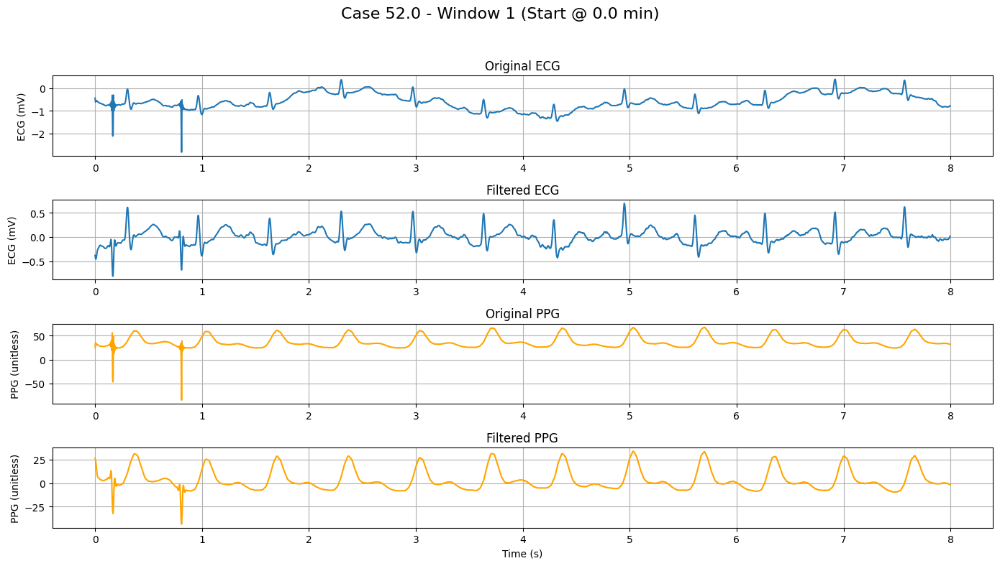

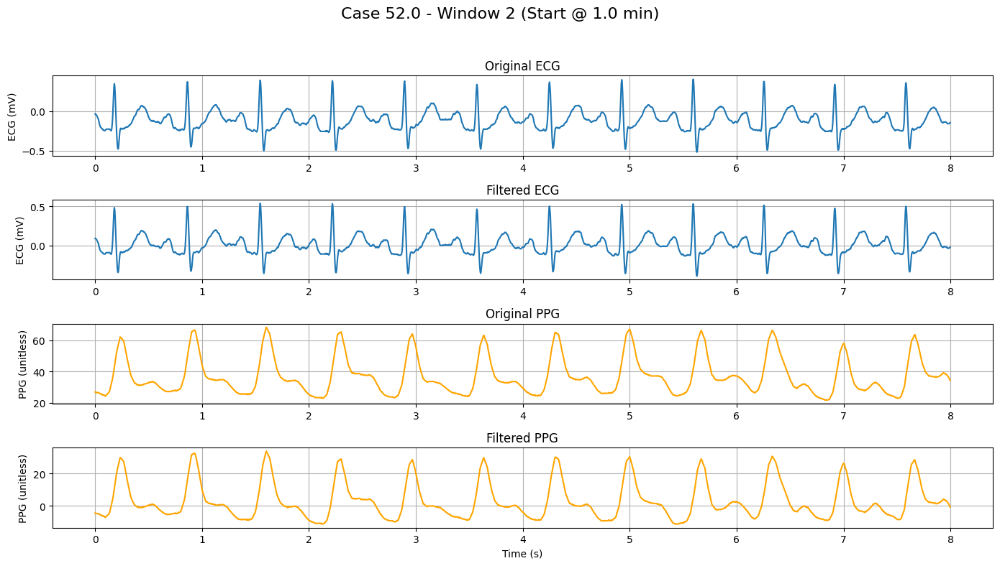

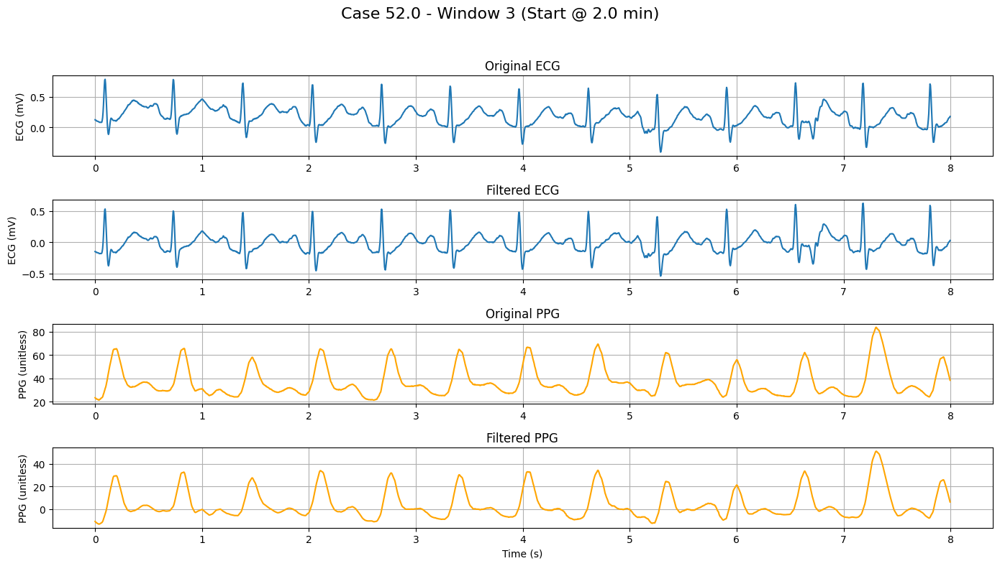

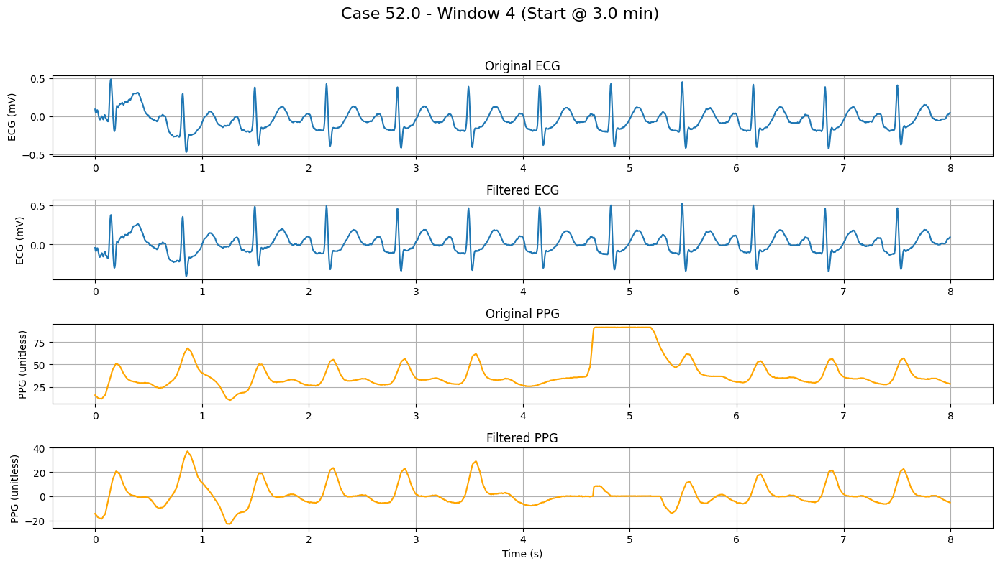

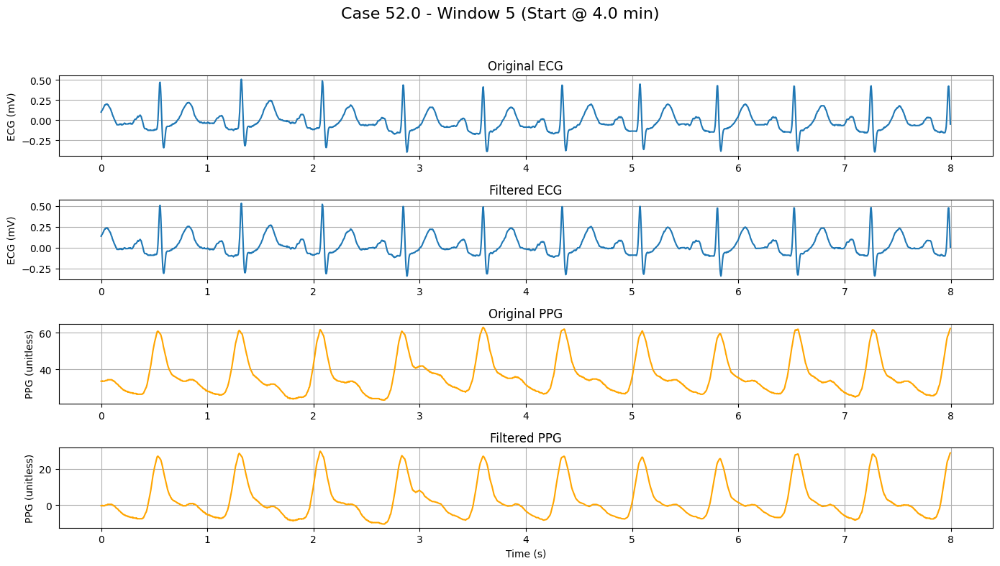

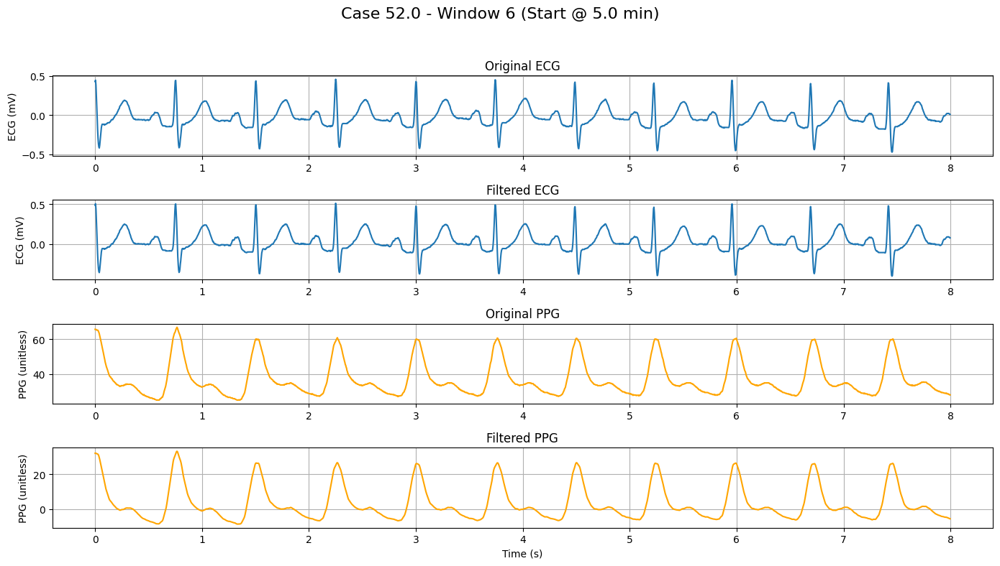

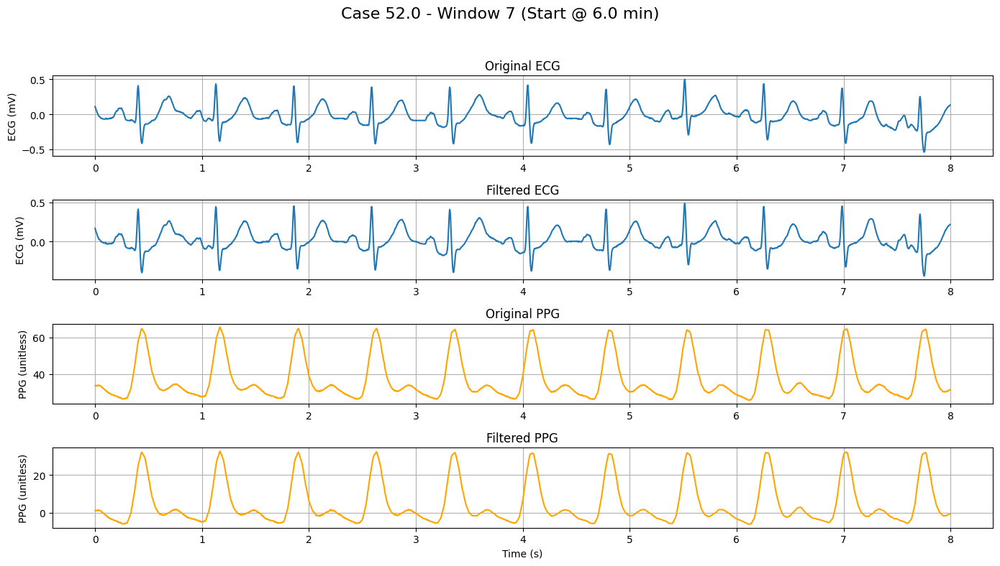

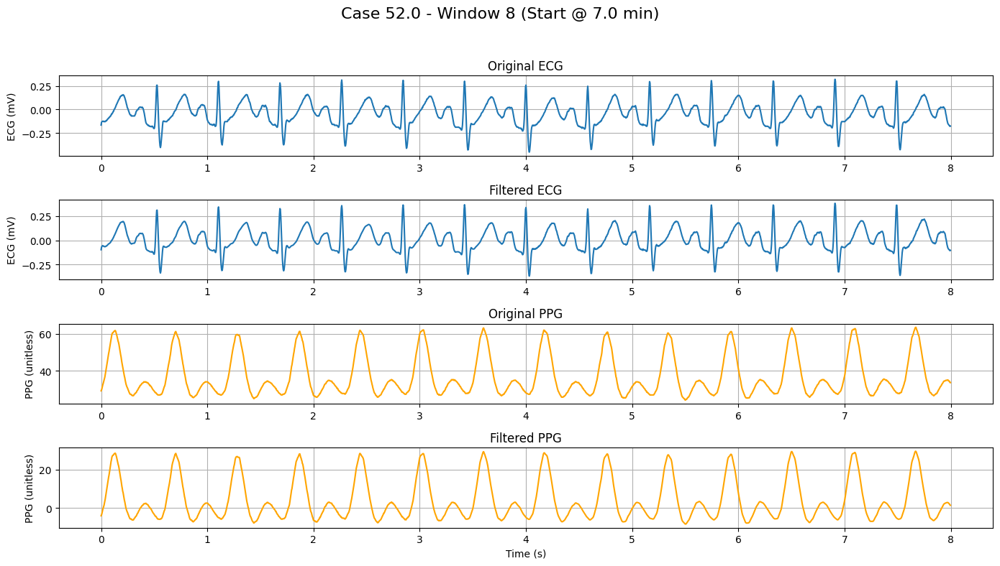

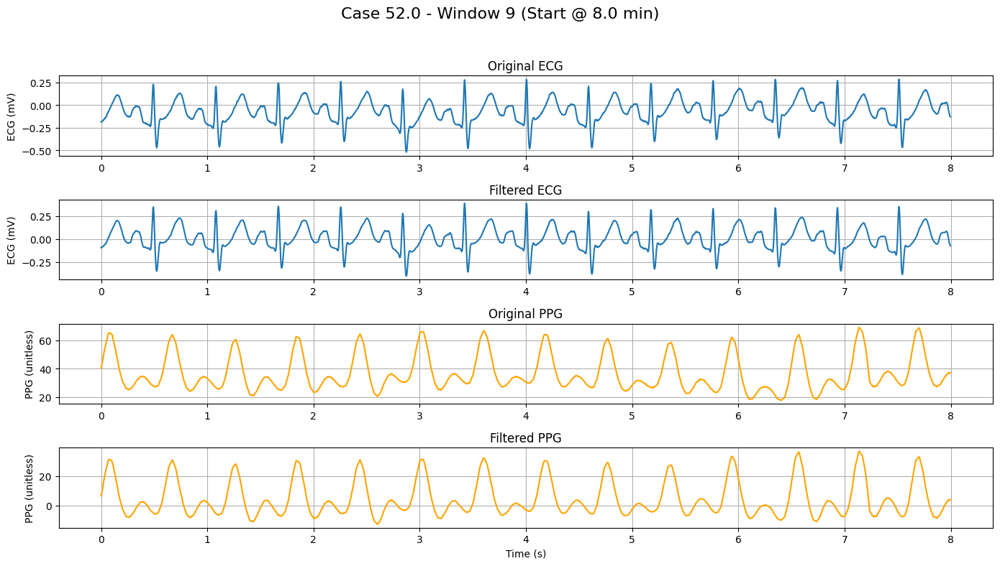

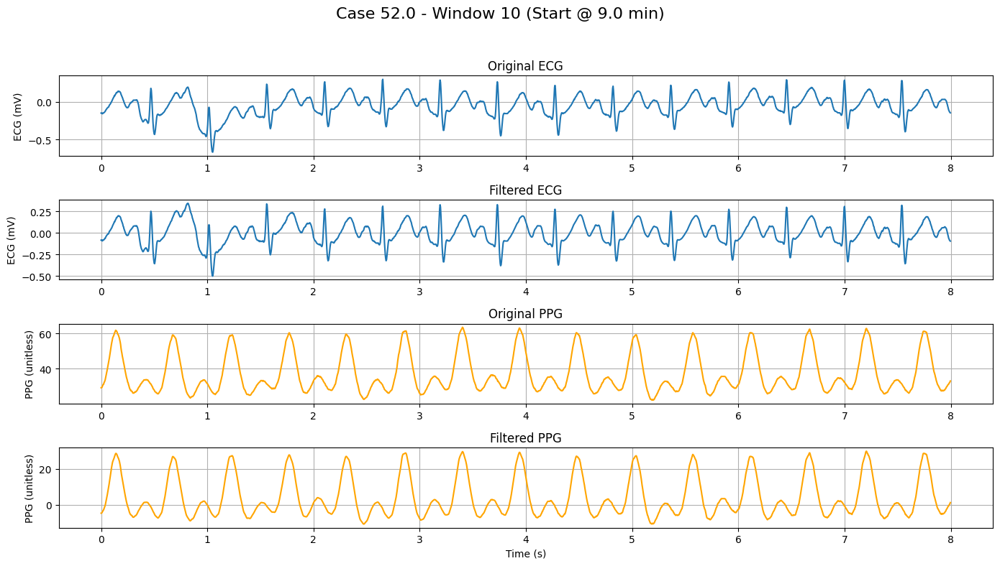


🩺 Processing Case 60.0...


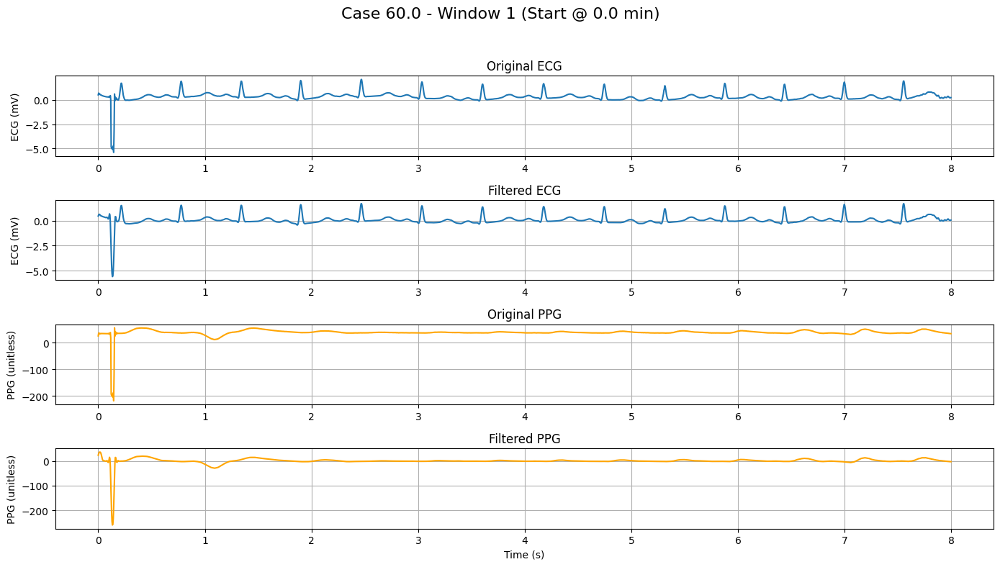

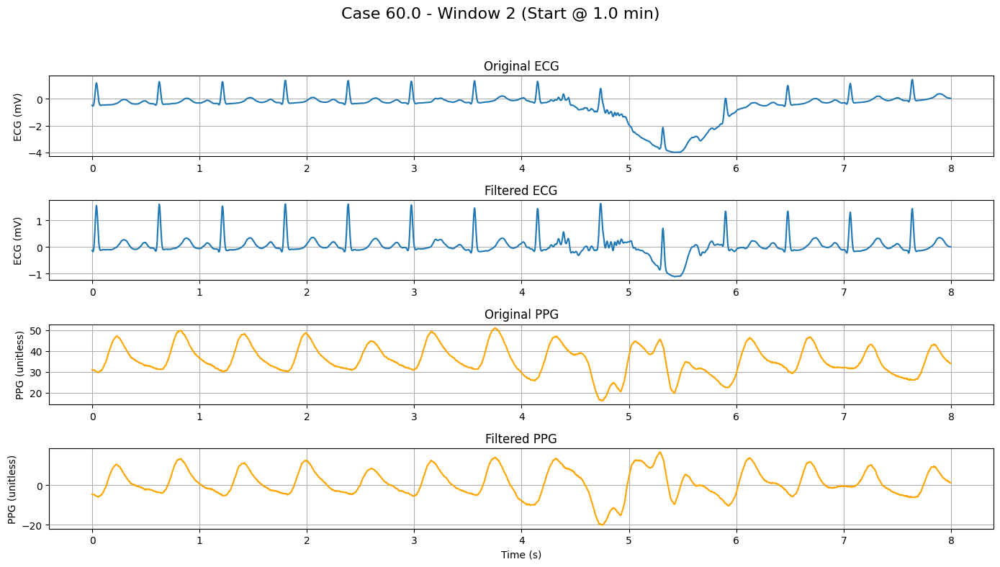

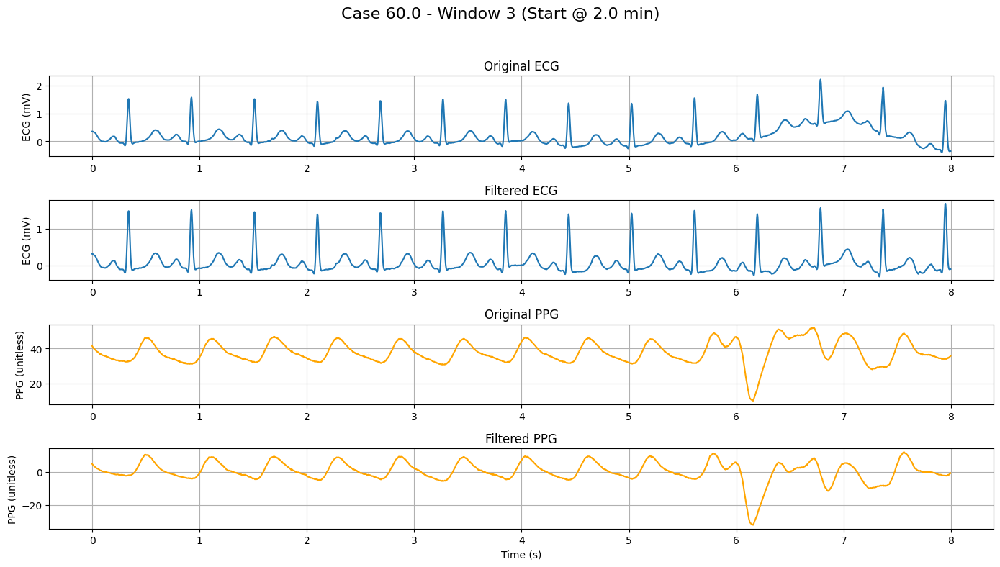

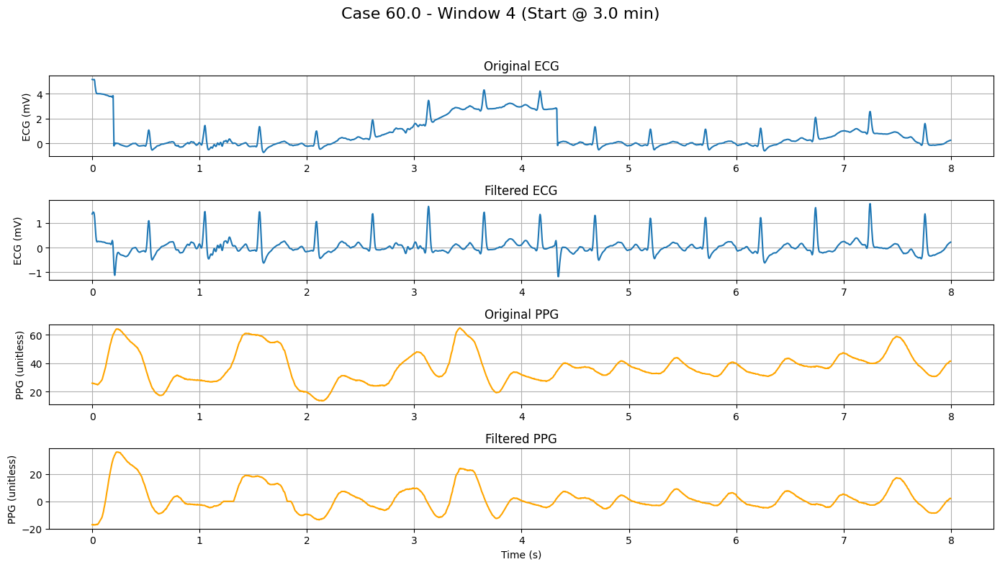

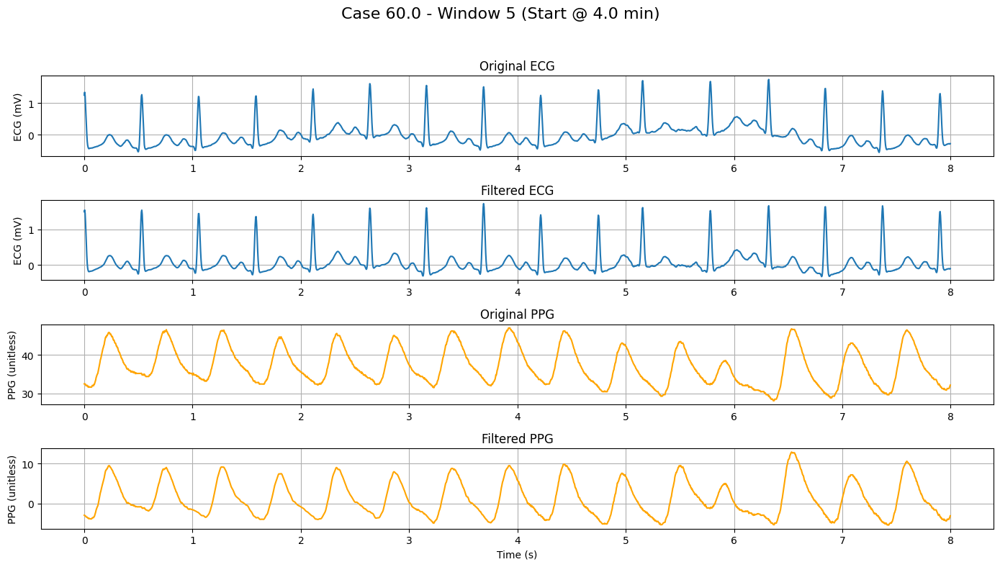

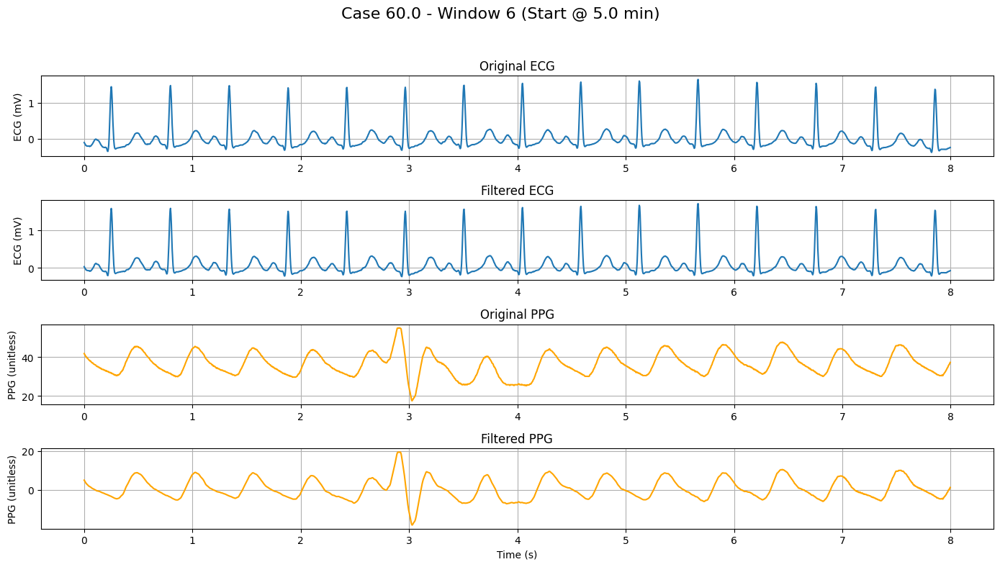

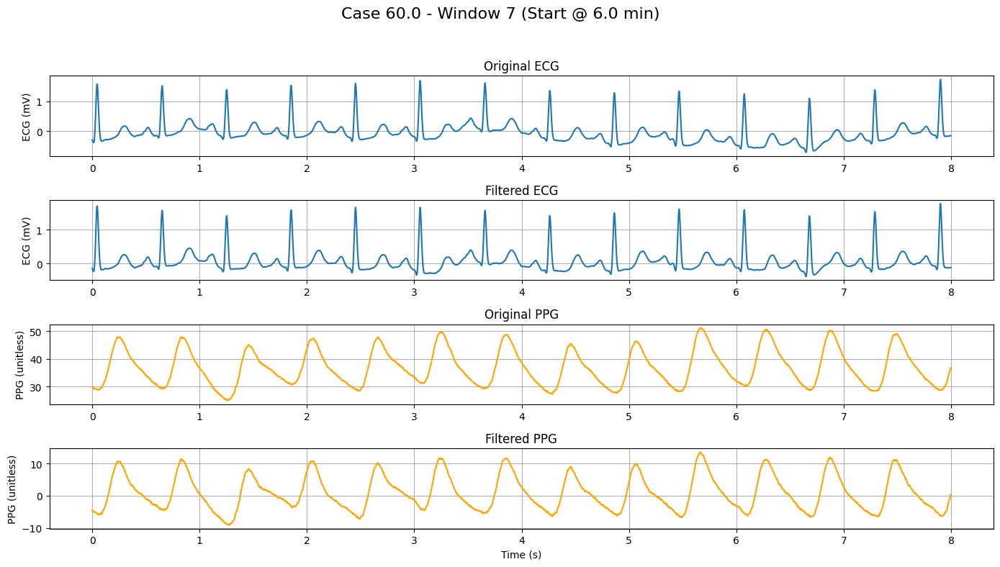

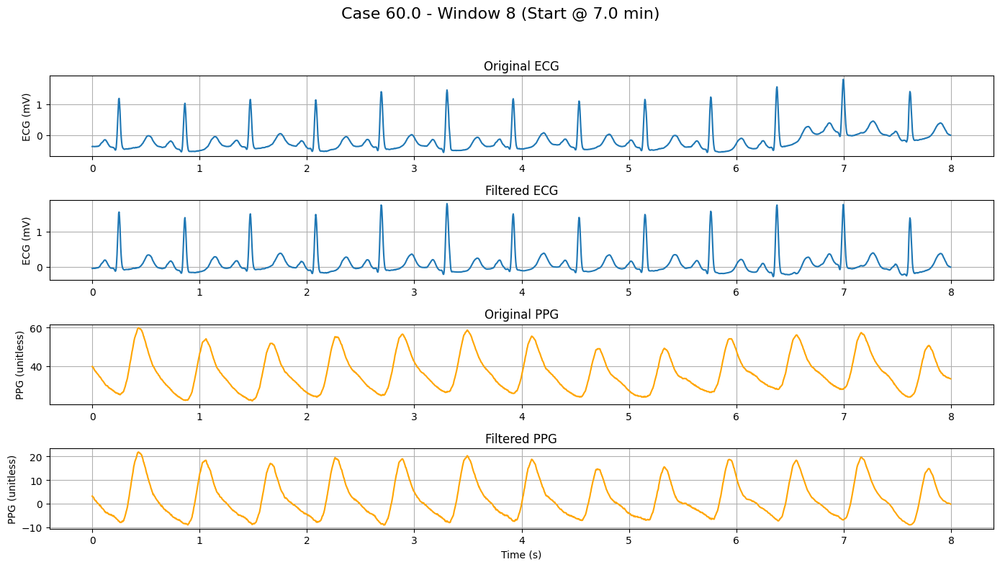

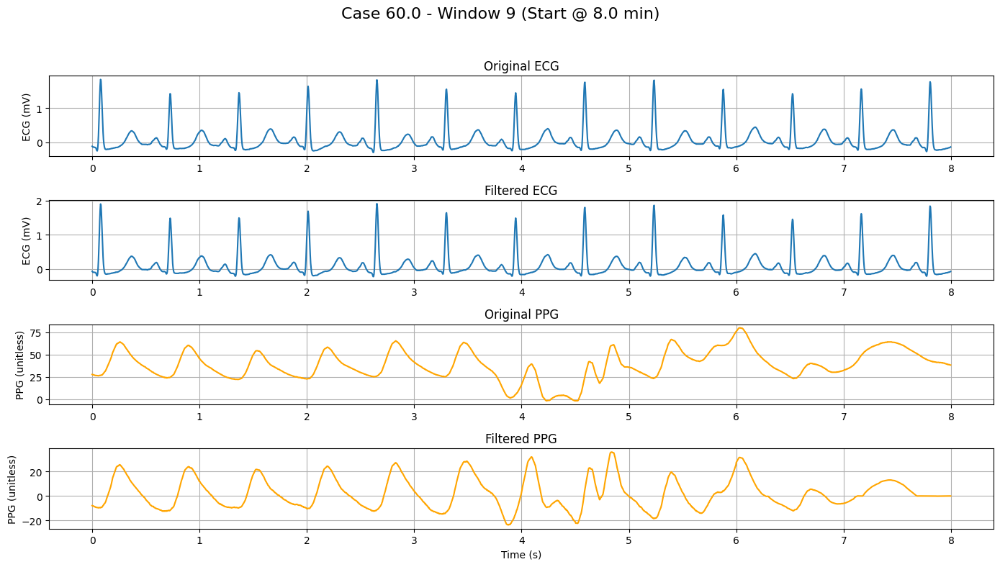

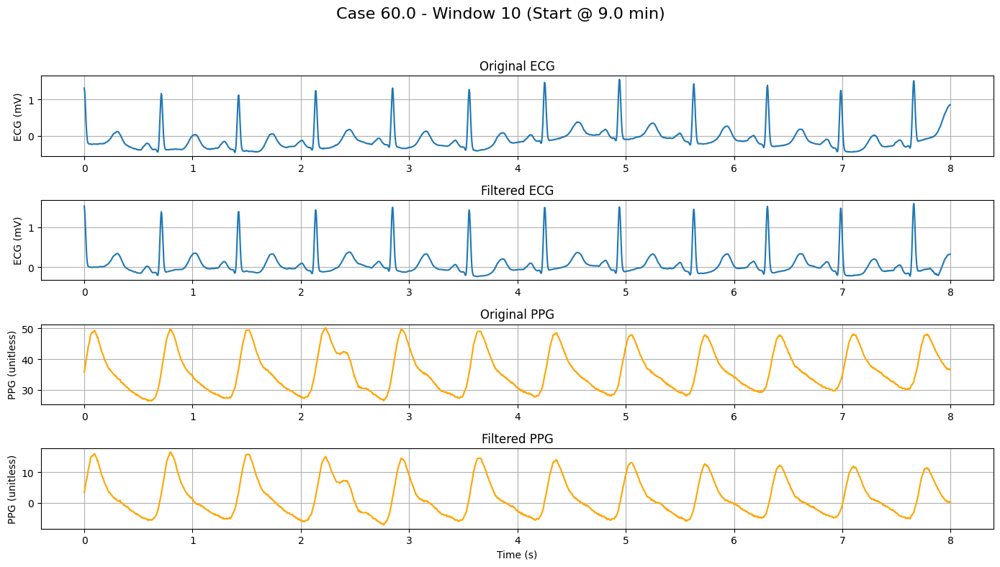


🩺 Processing Case 58.0...


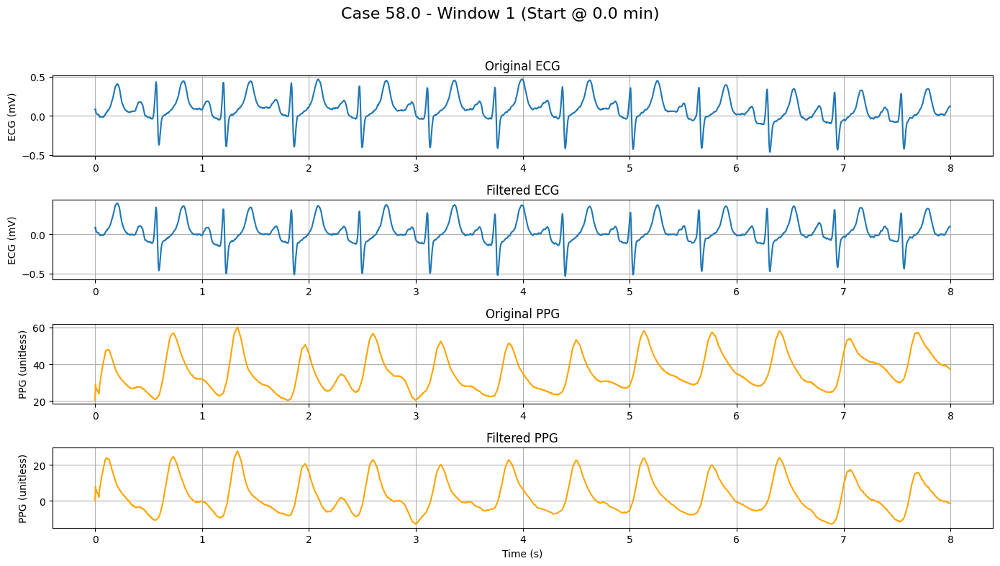

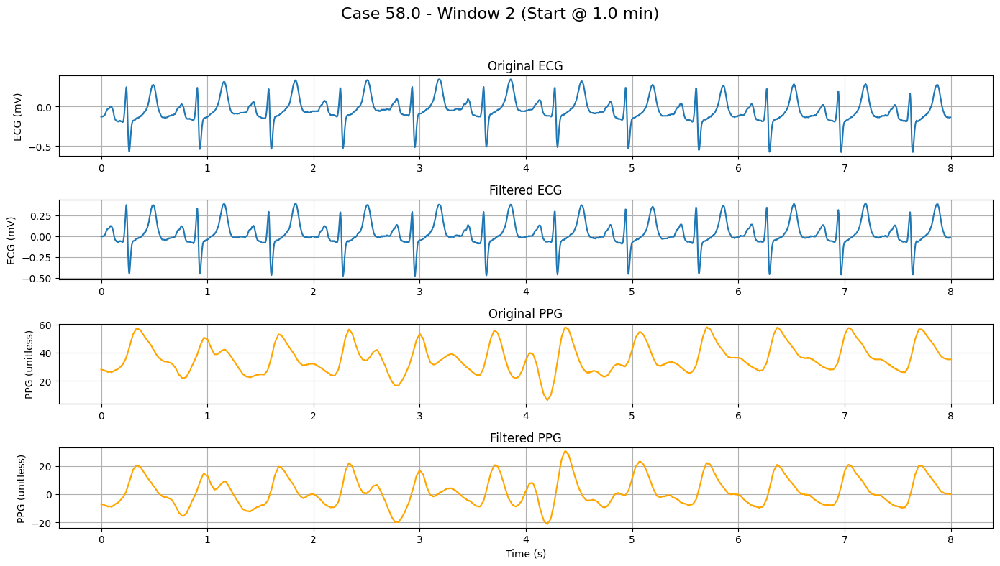

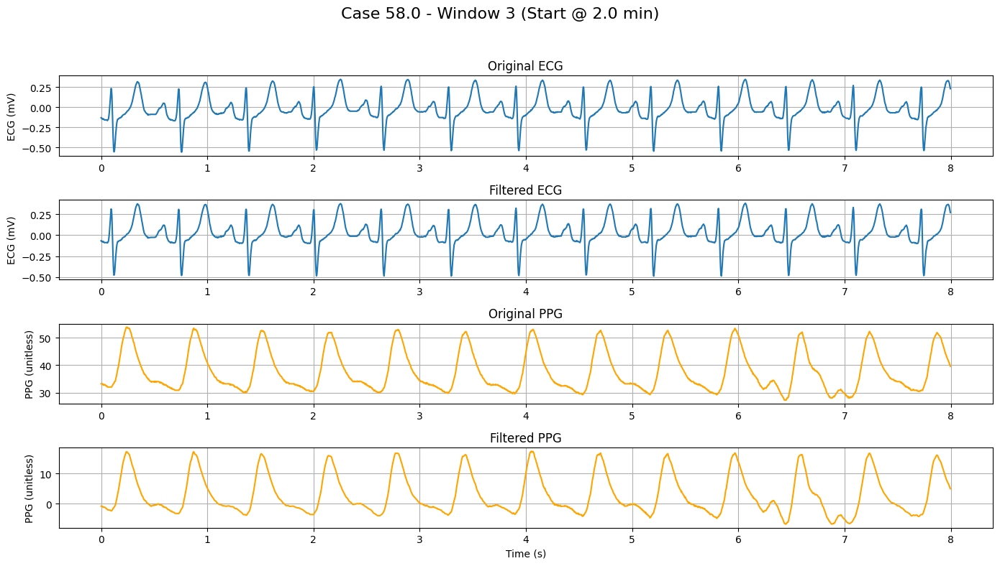

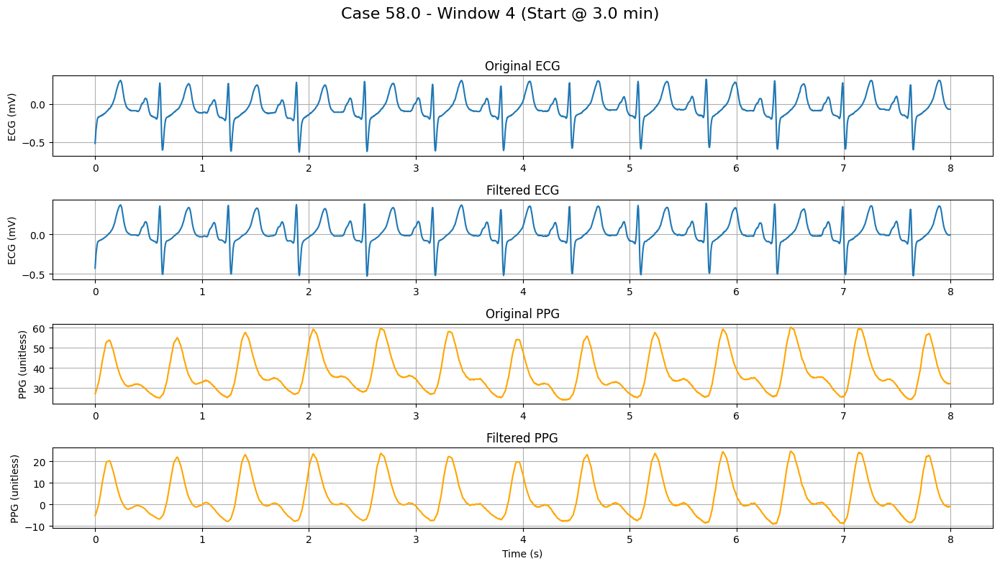

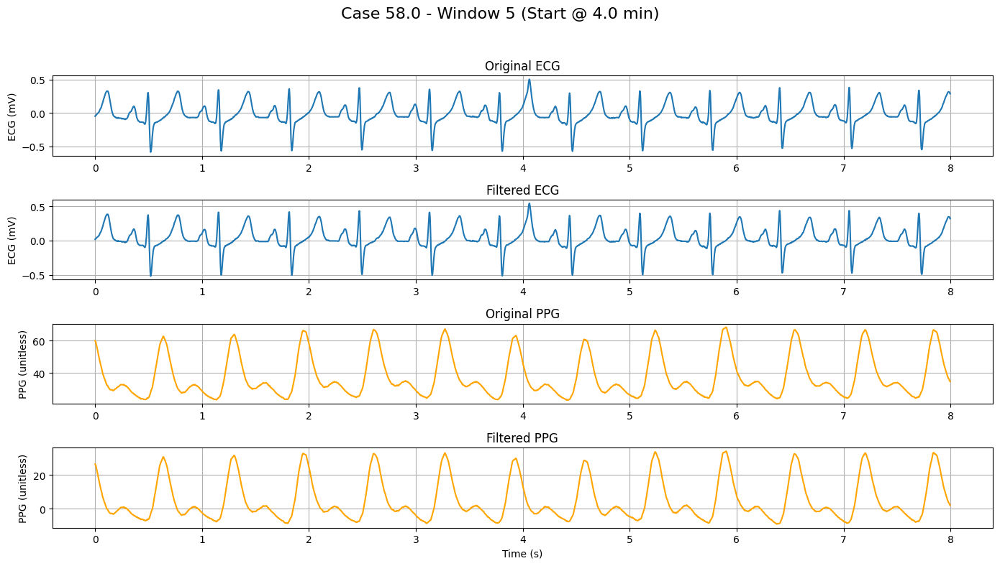

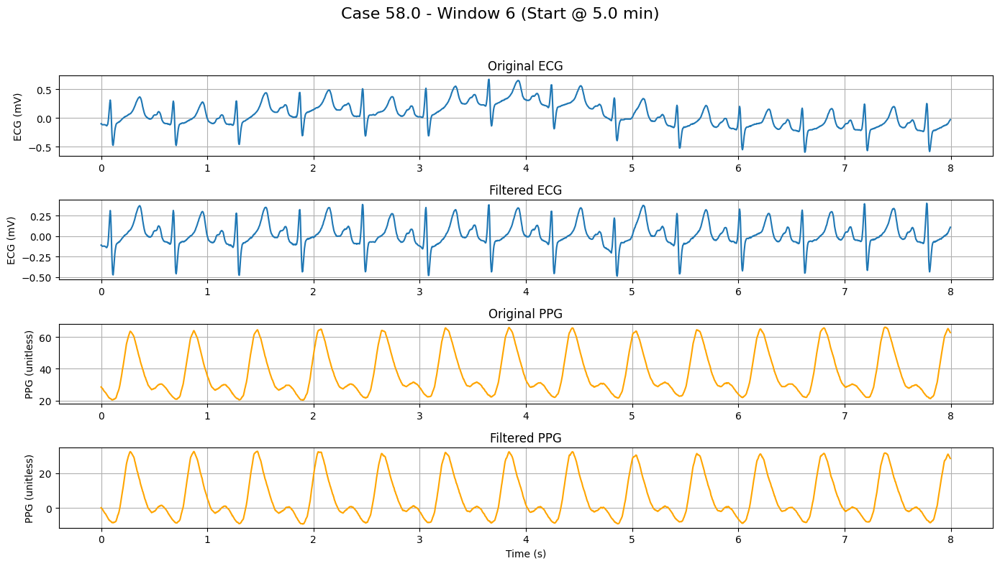

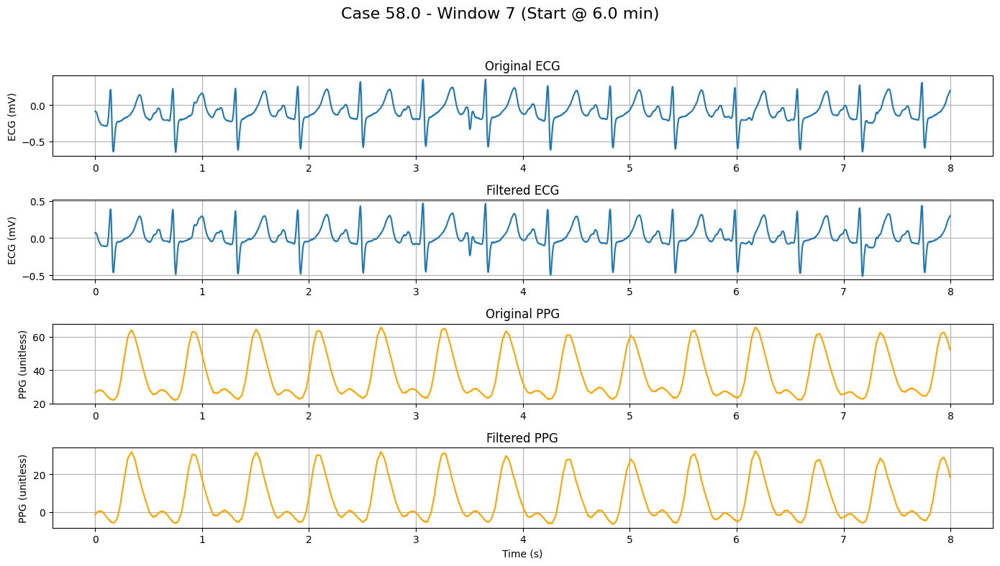

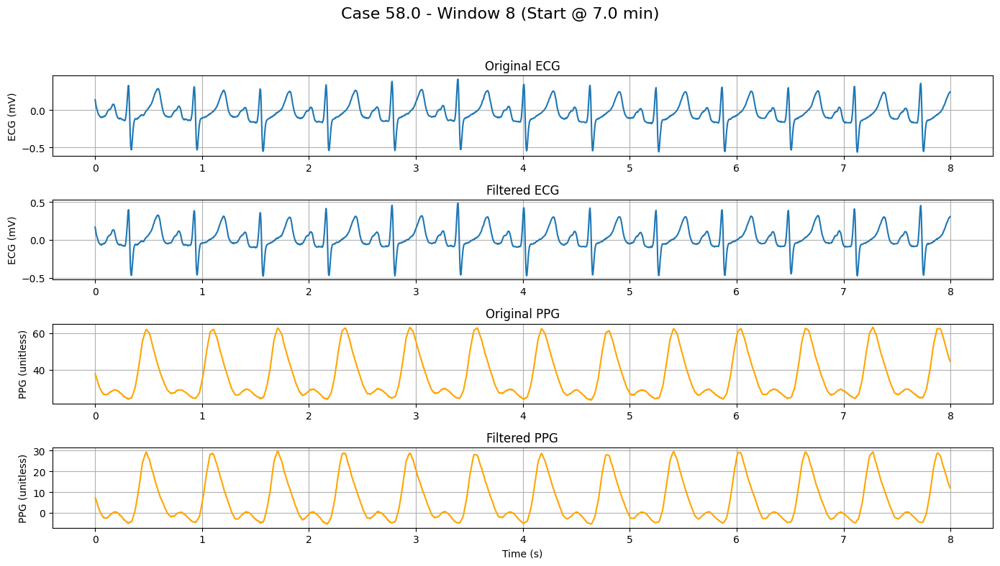

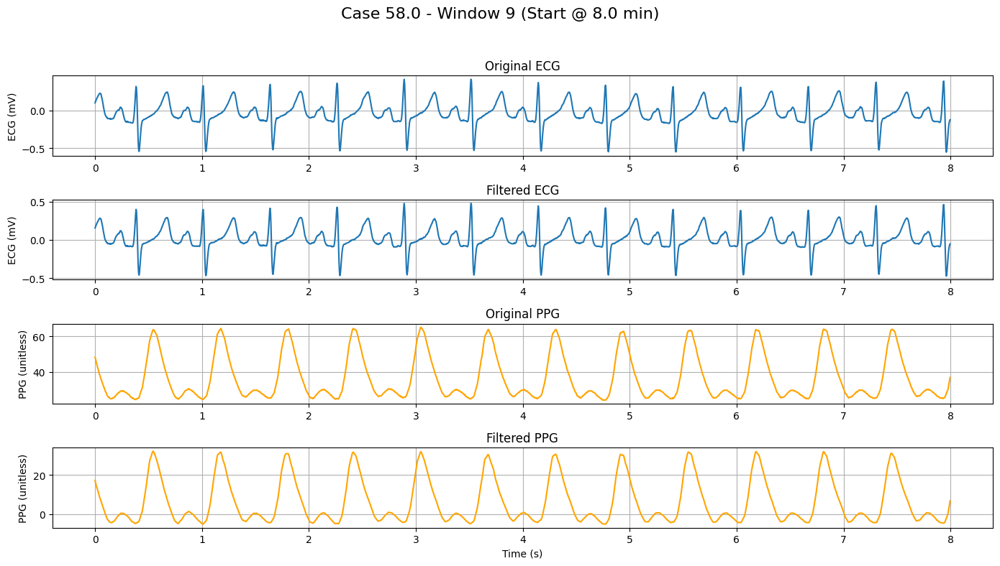

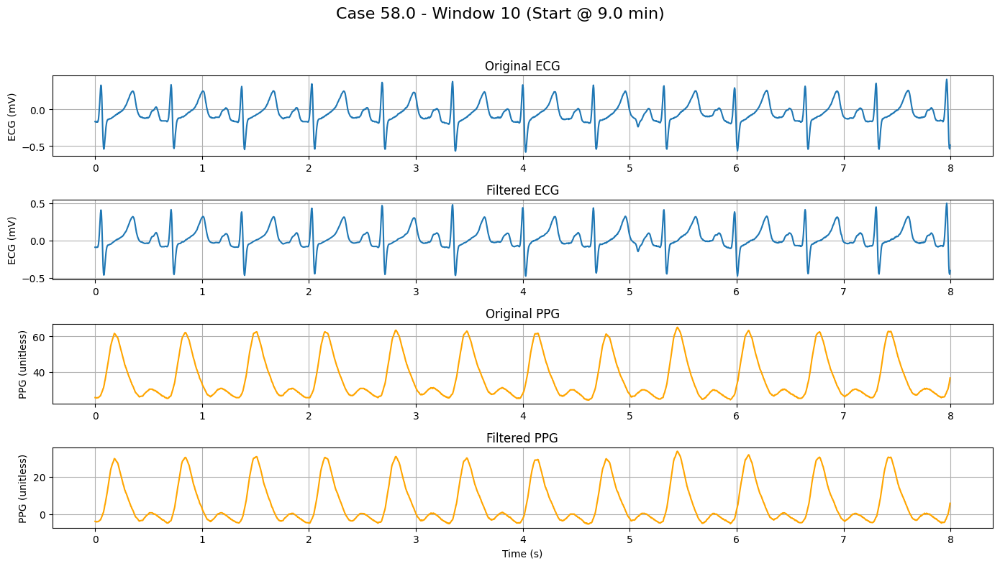


🩺 Processing Case 16.0...


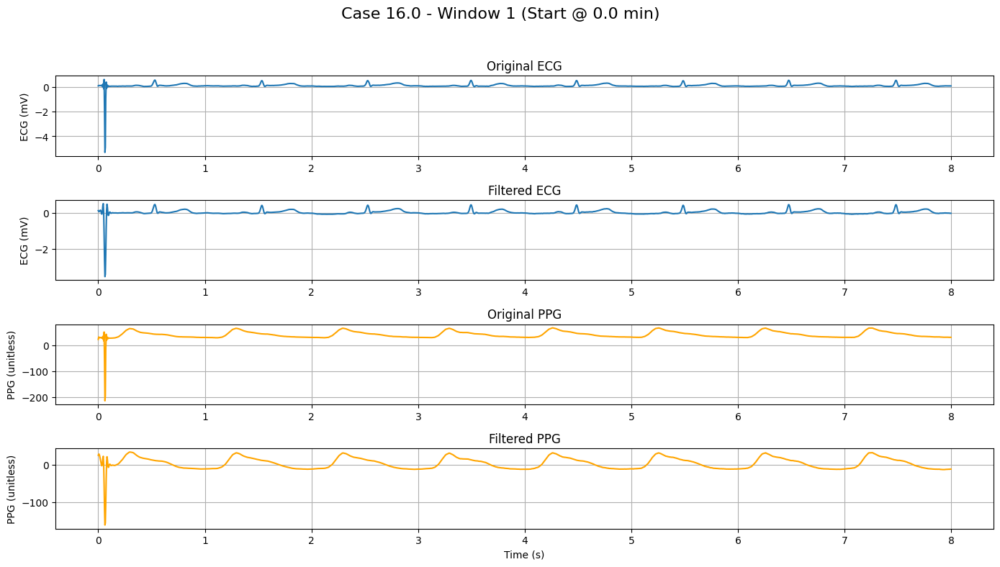

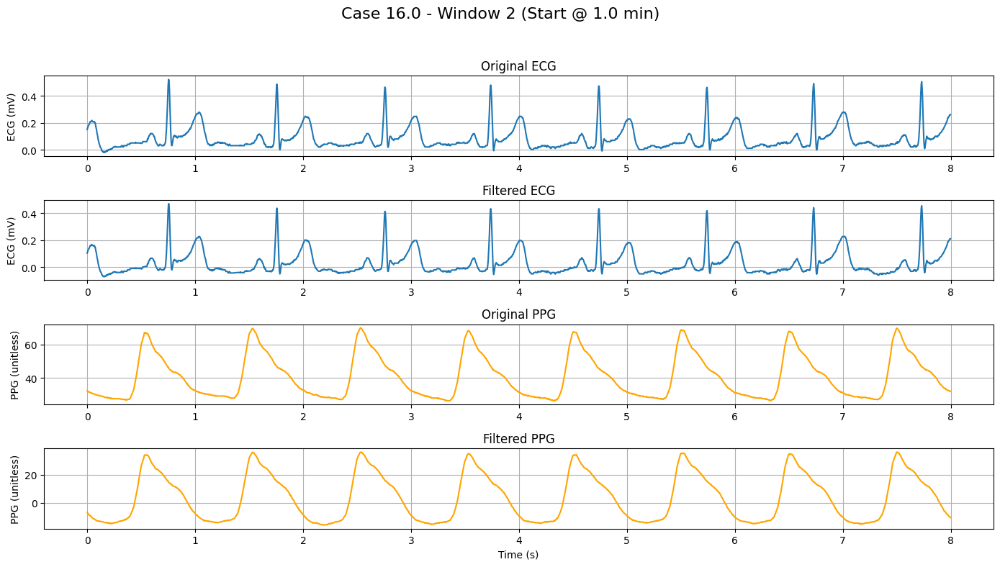

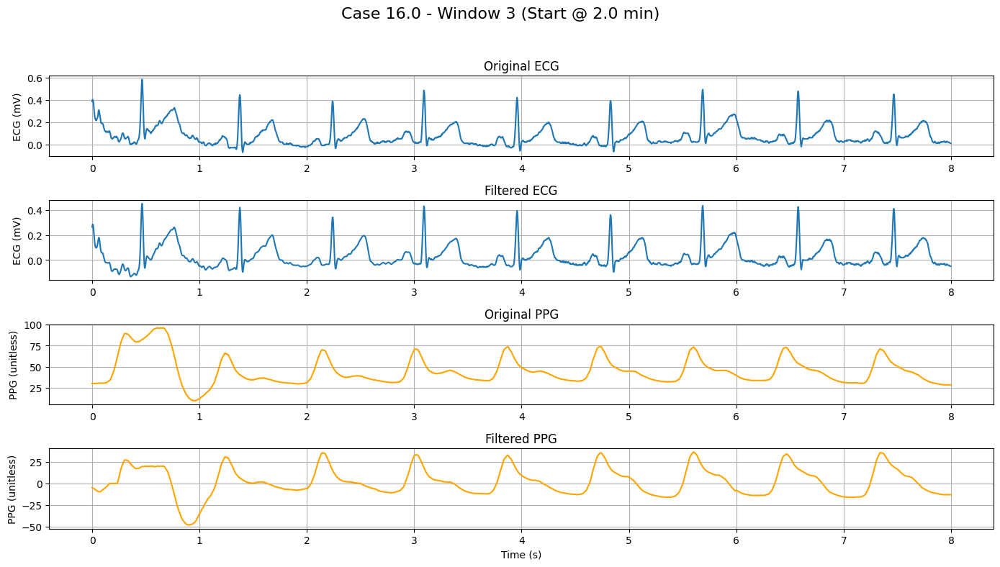

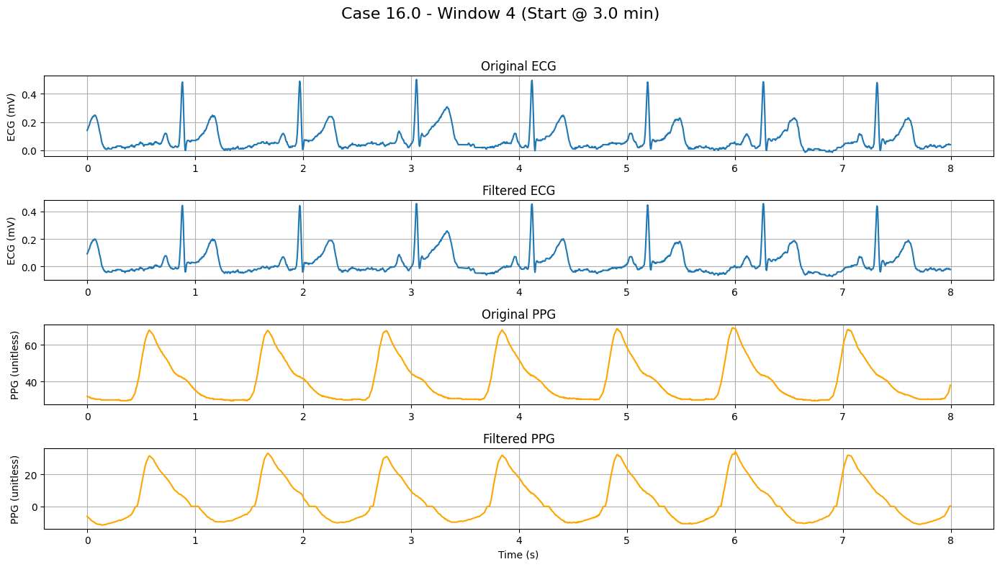

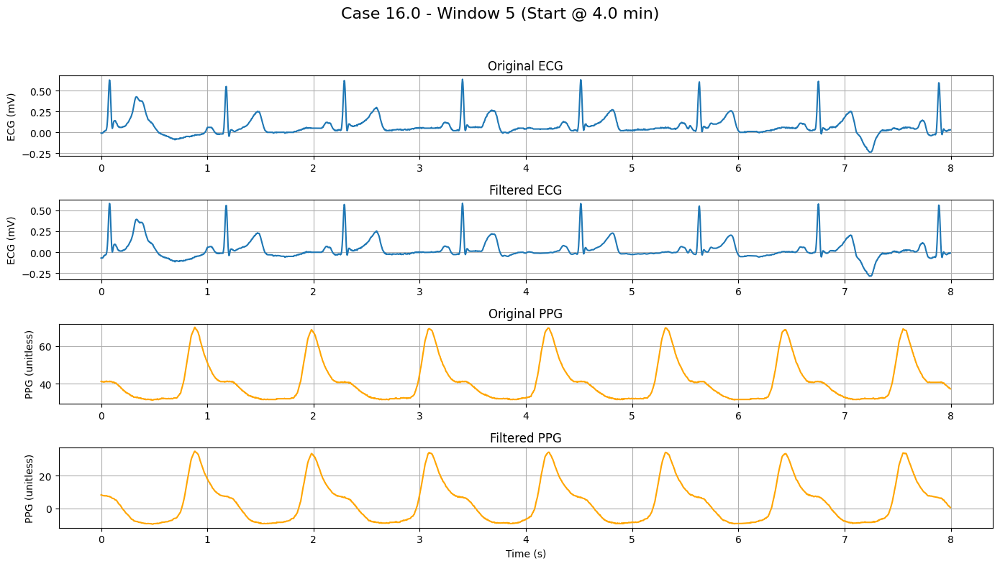

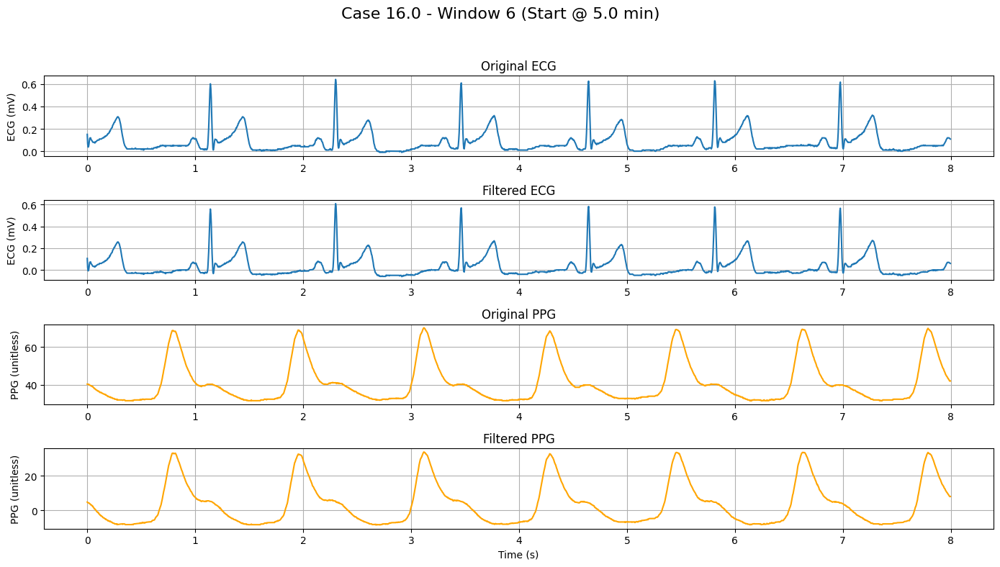

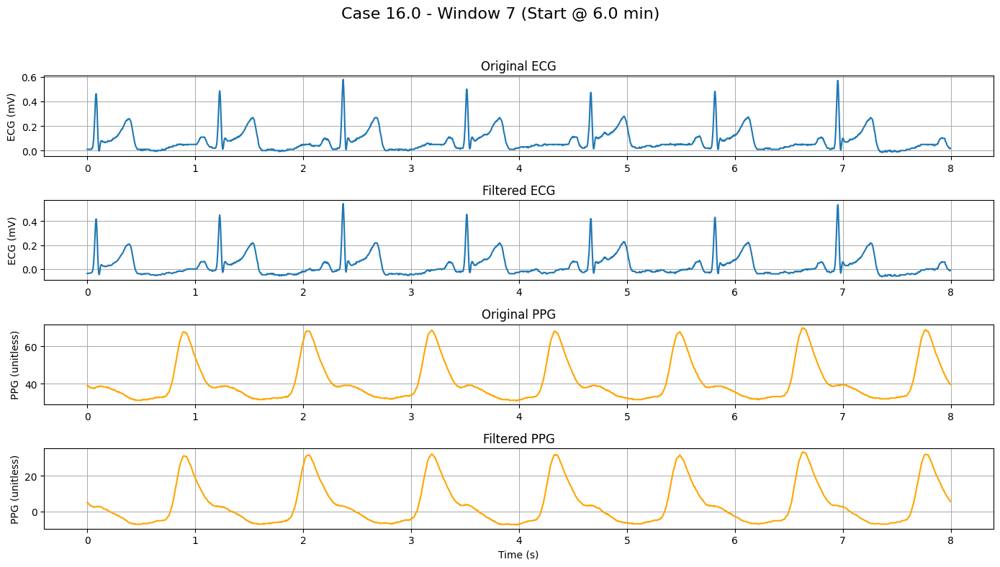

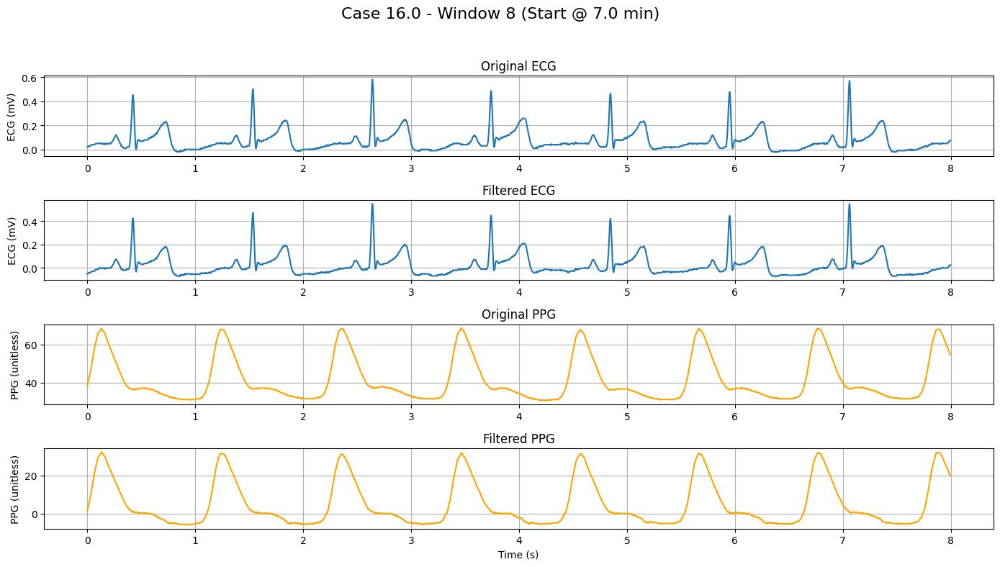

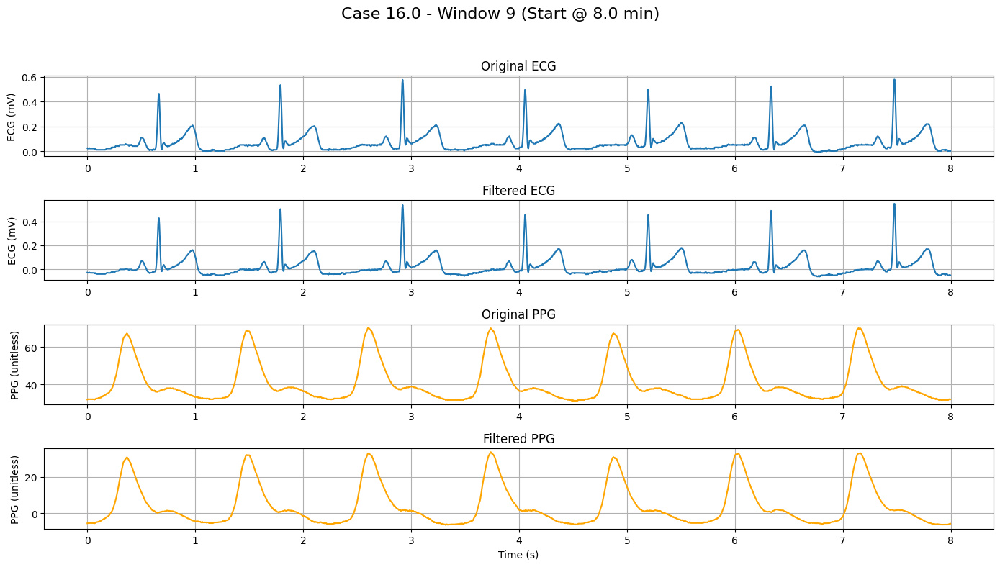

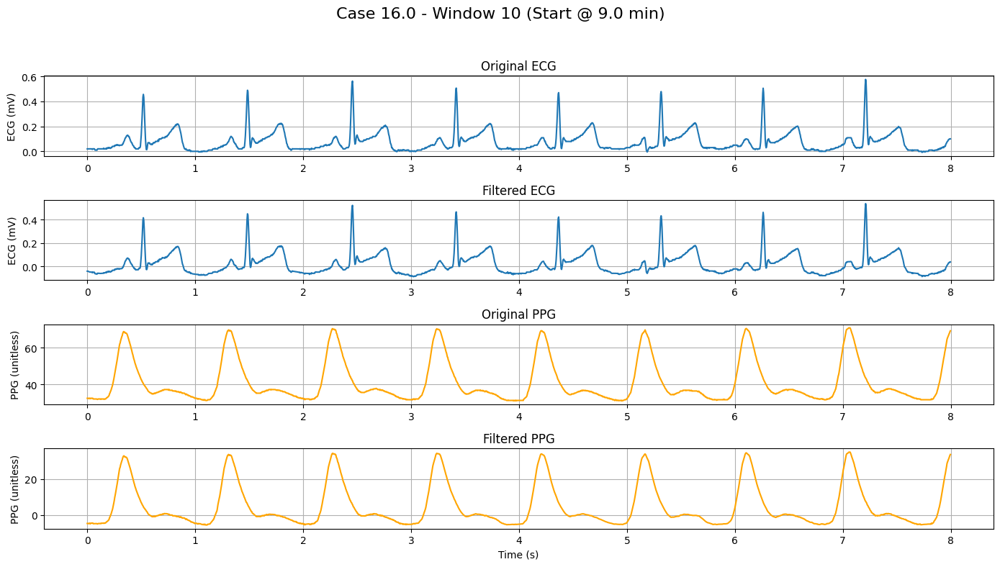


🩺 Processing Case 51.0...


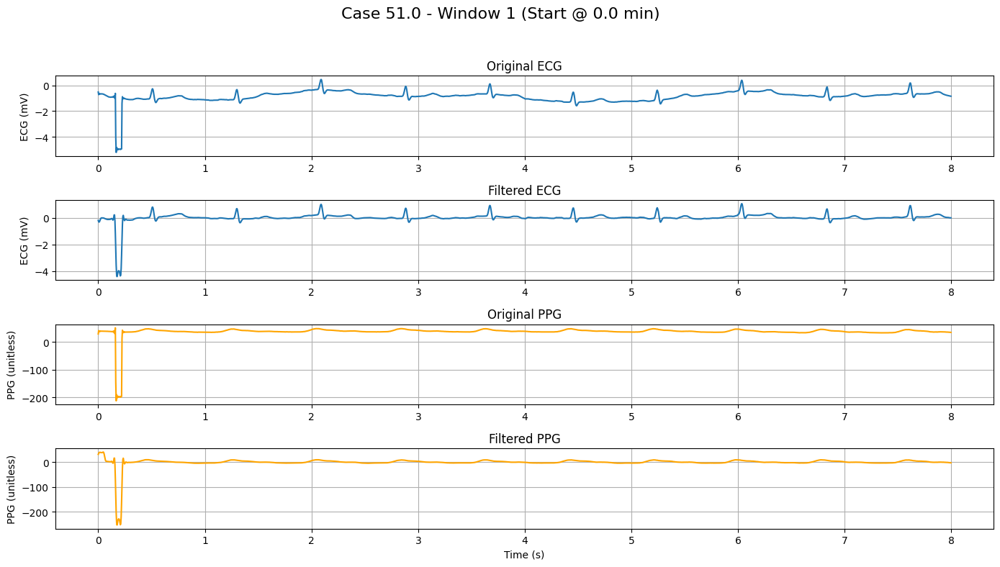

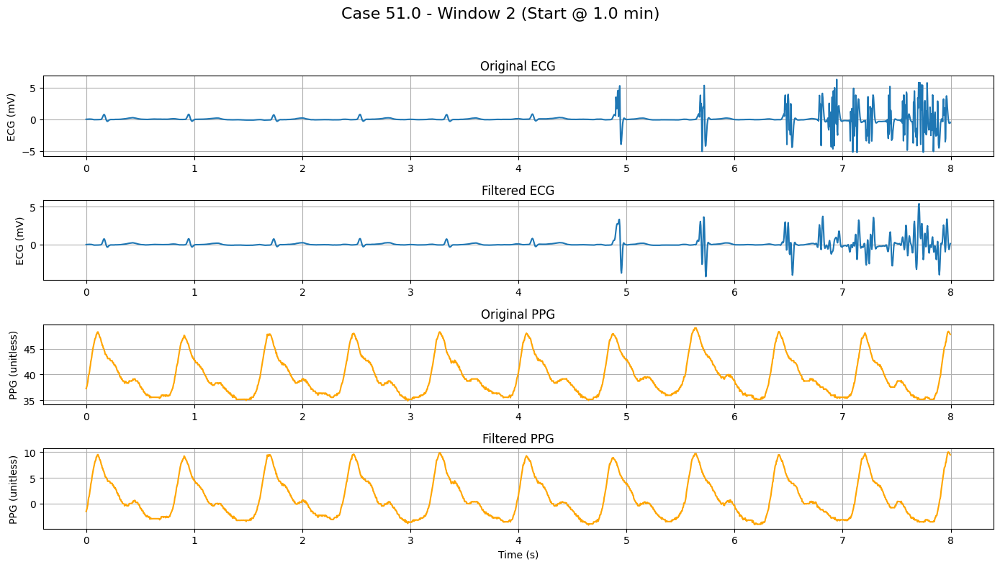

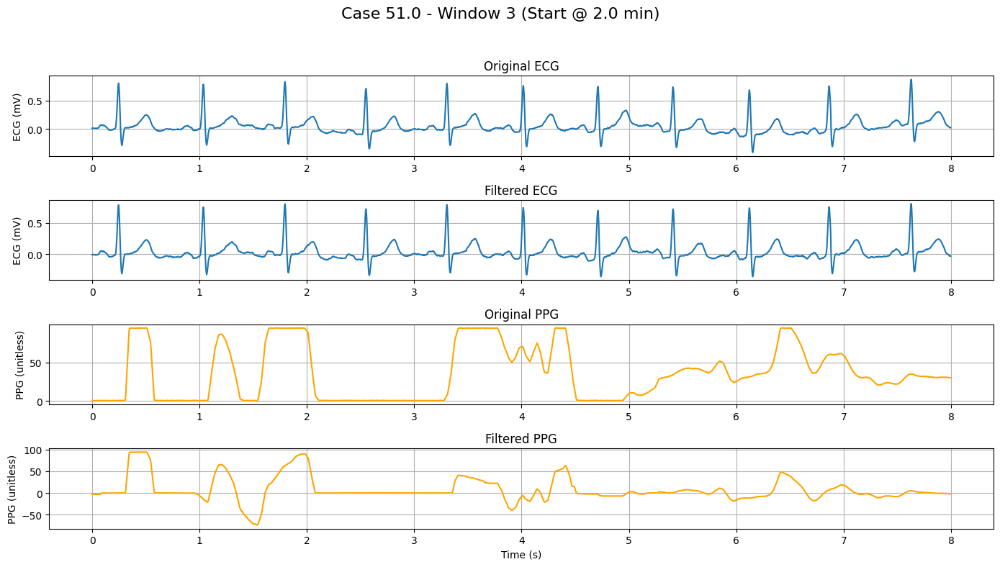

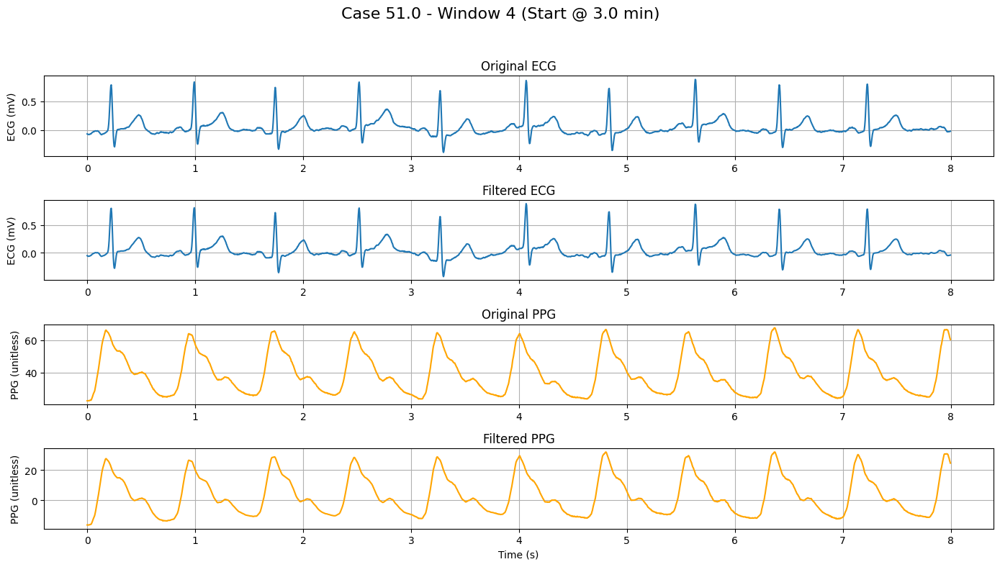

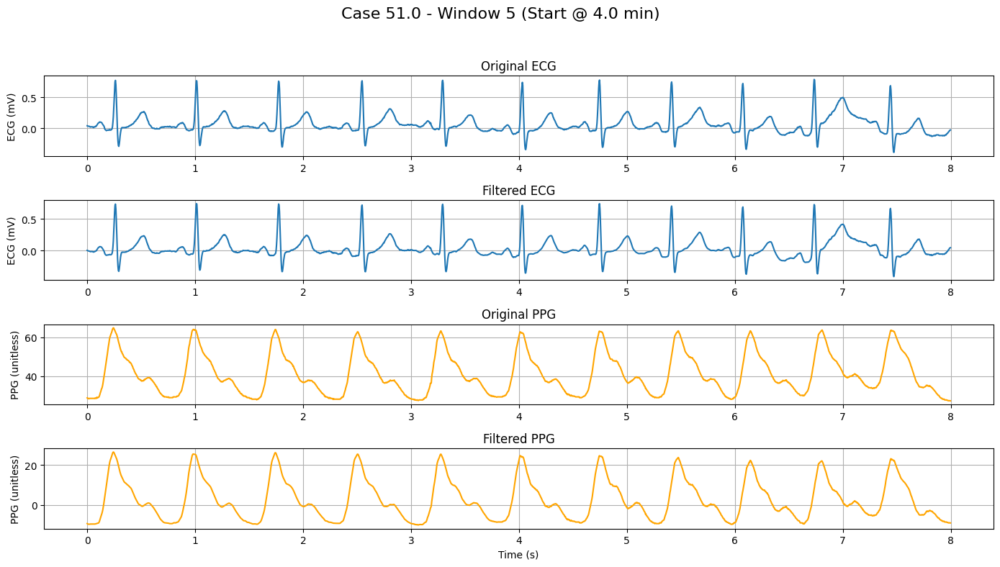

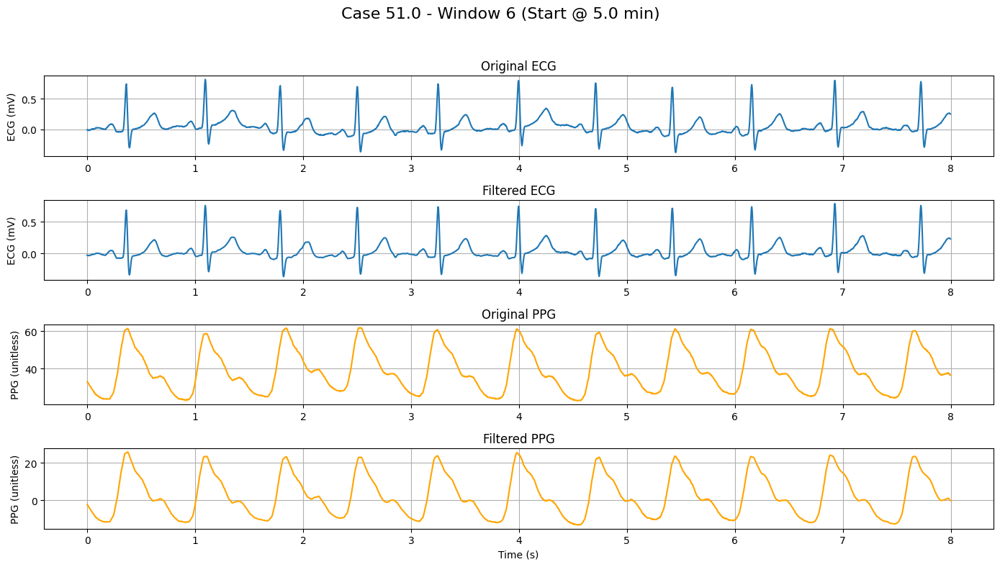

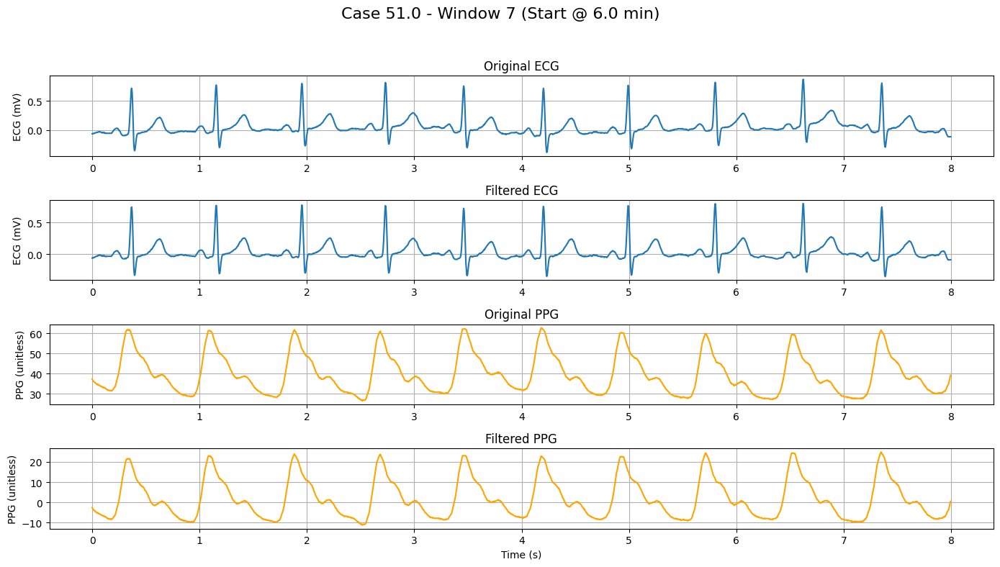

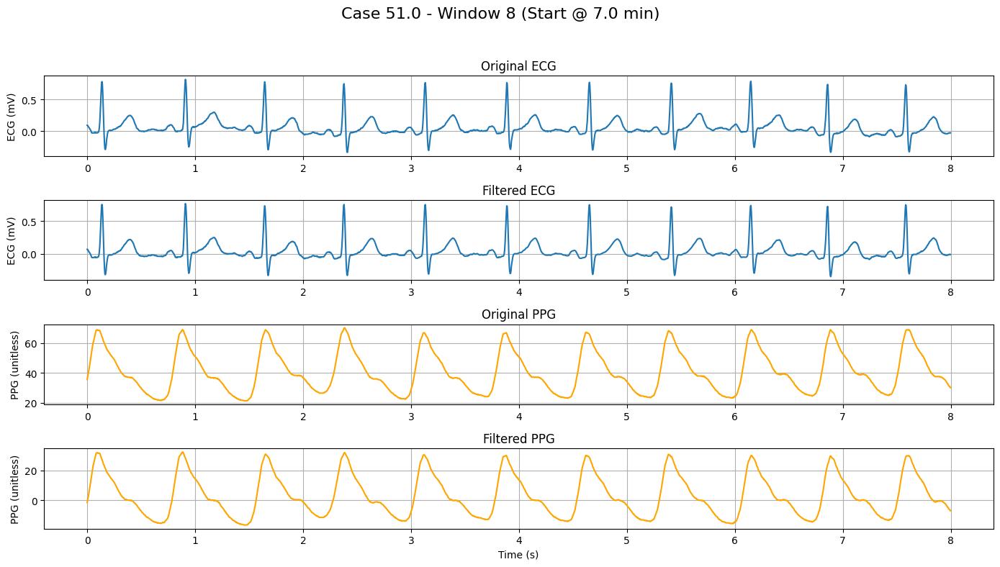

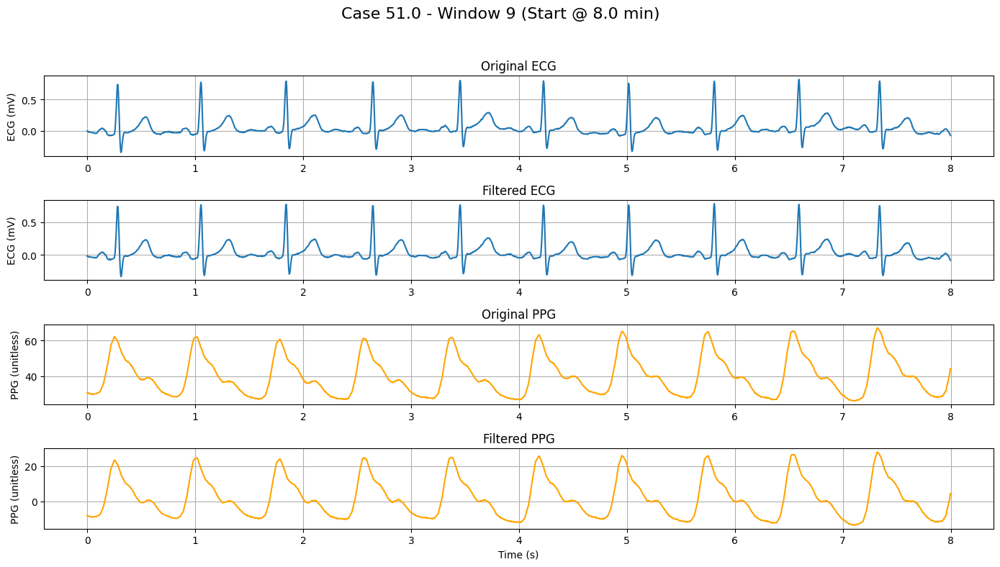

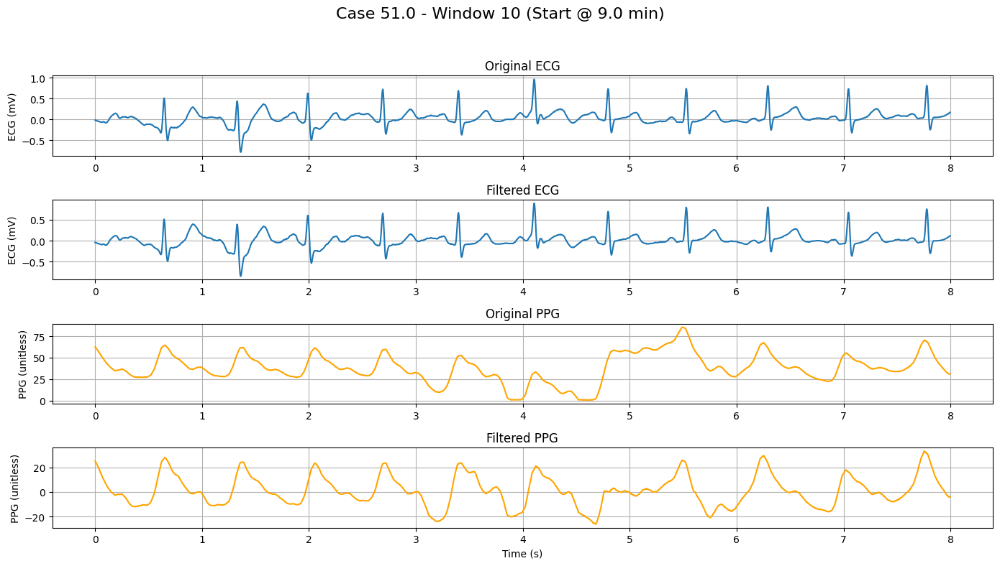


🩺 Processing Case 42.0...


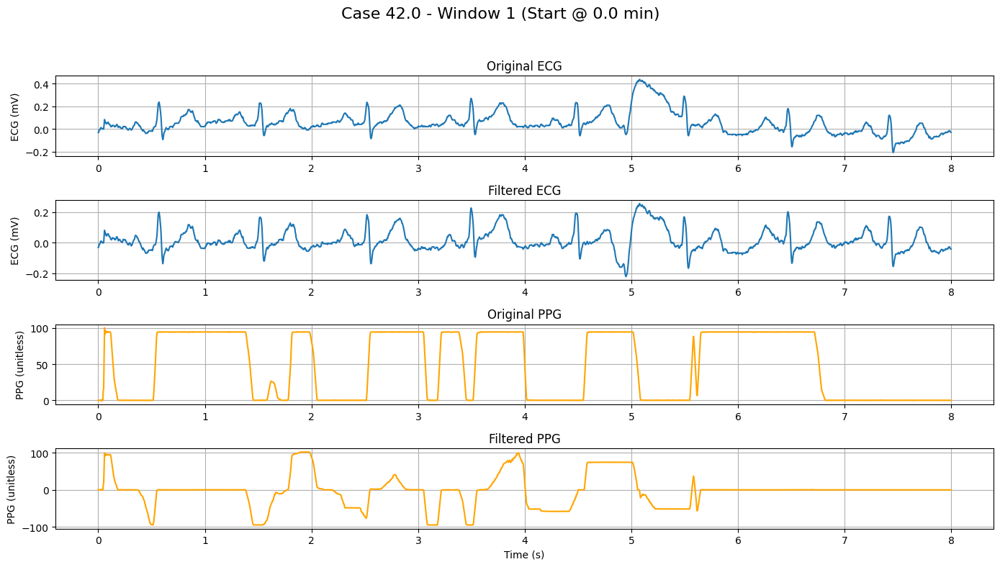

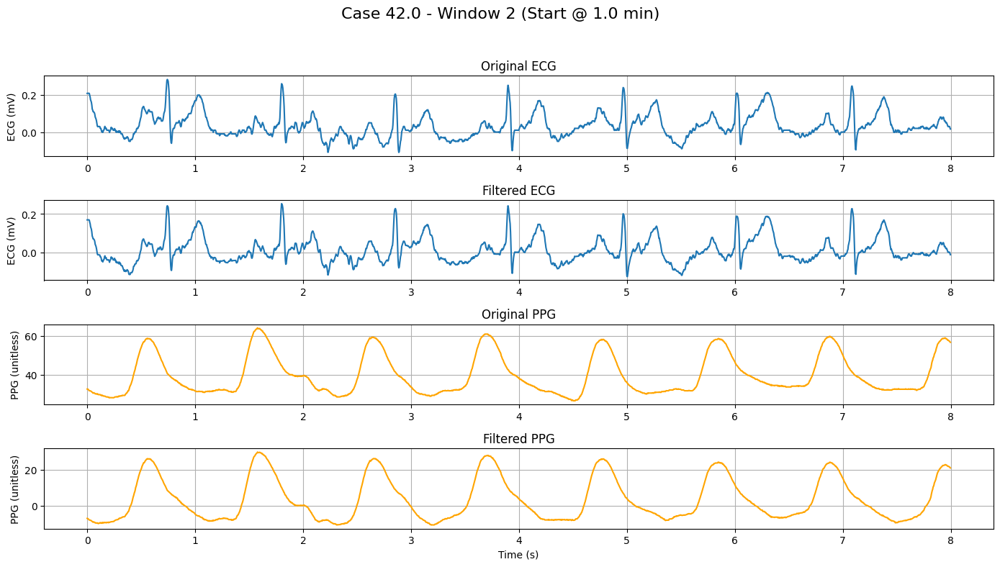

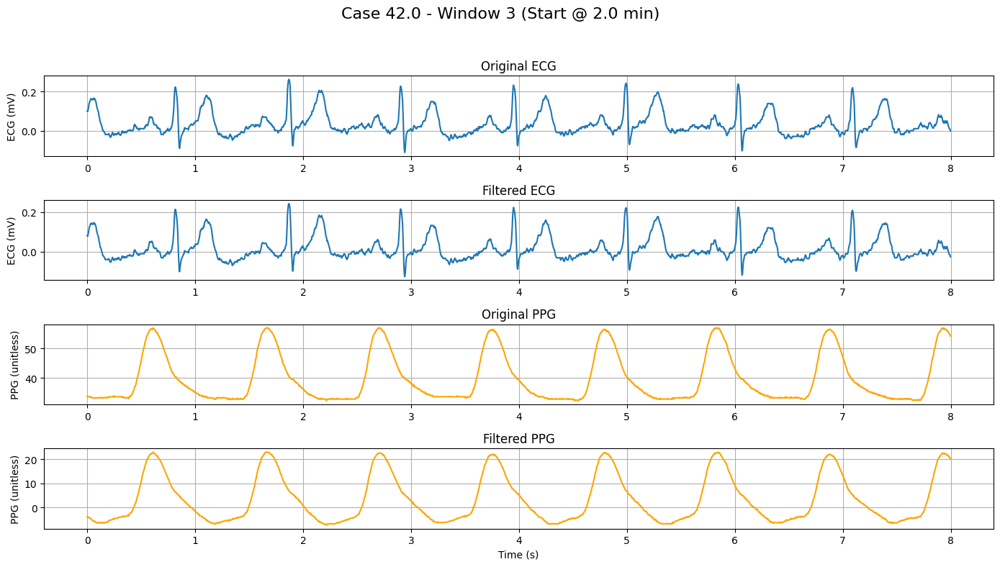

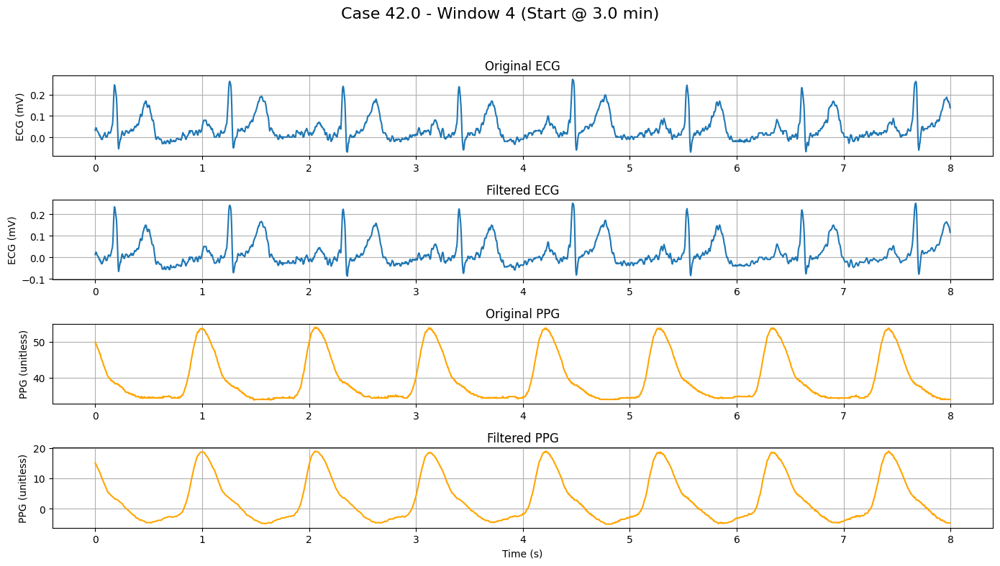

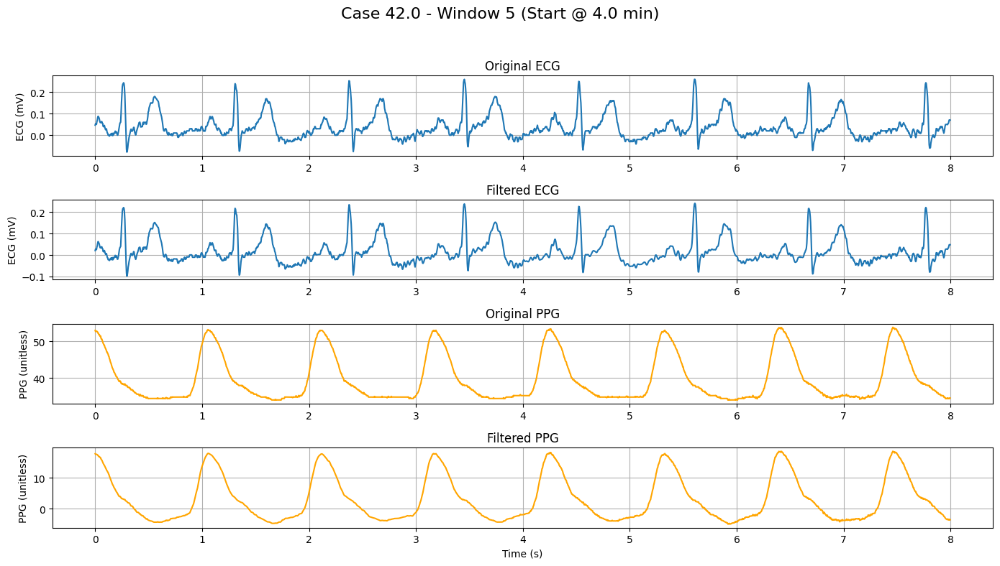

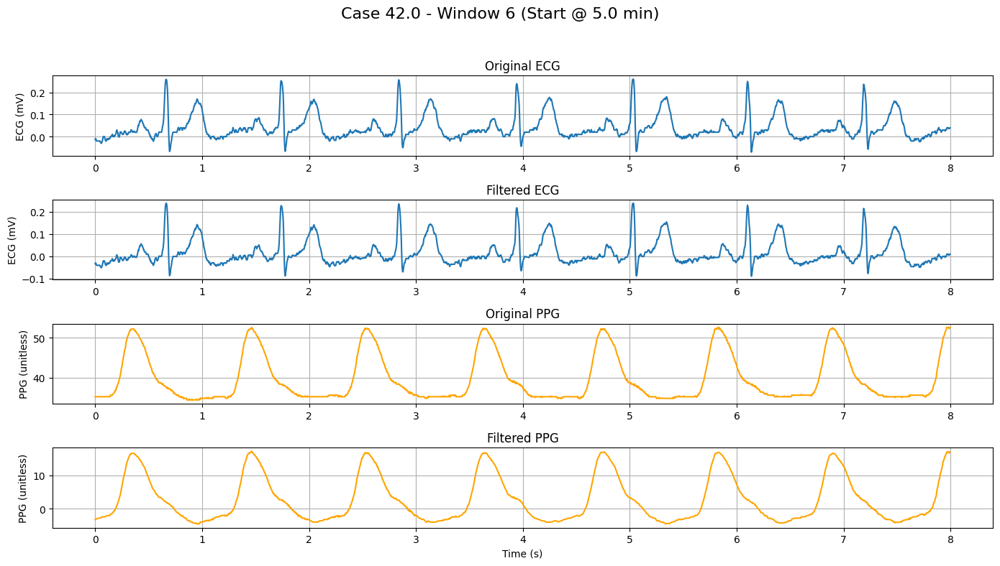

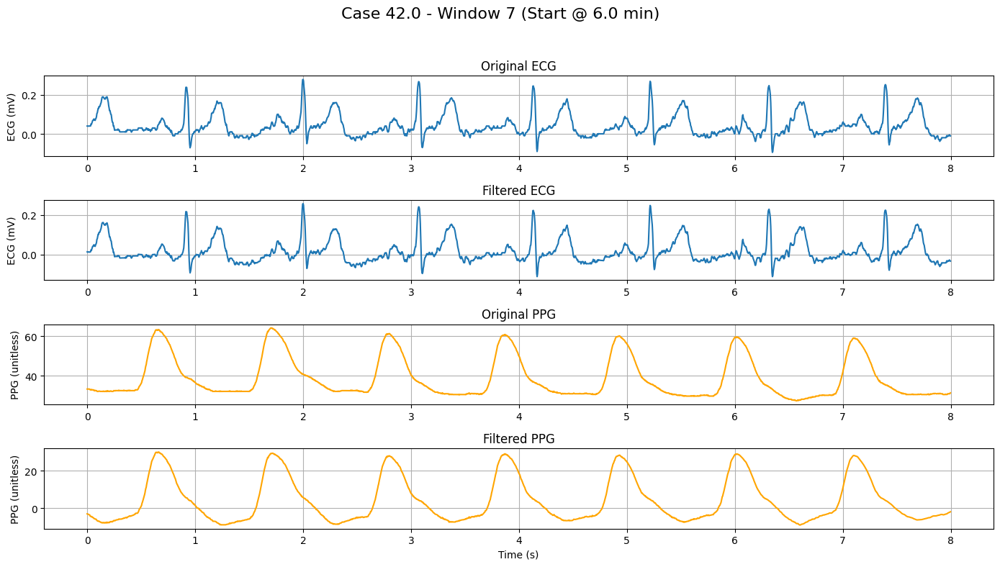

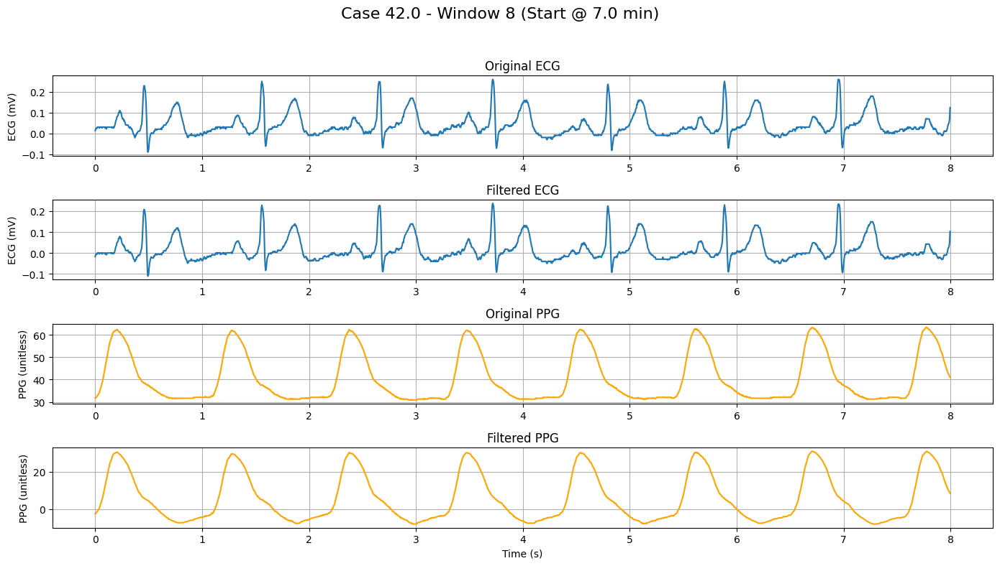

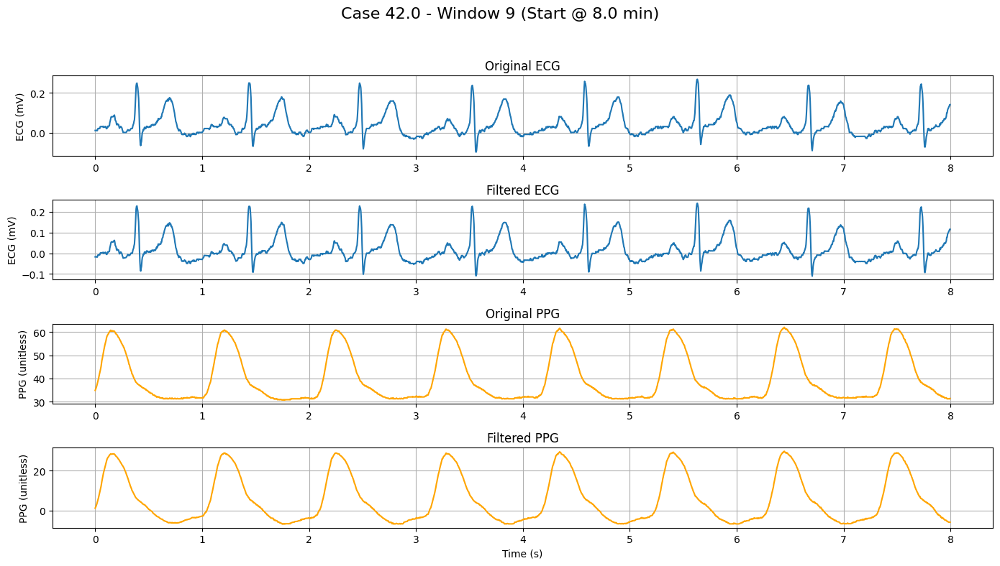

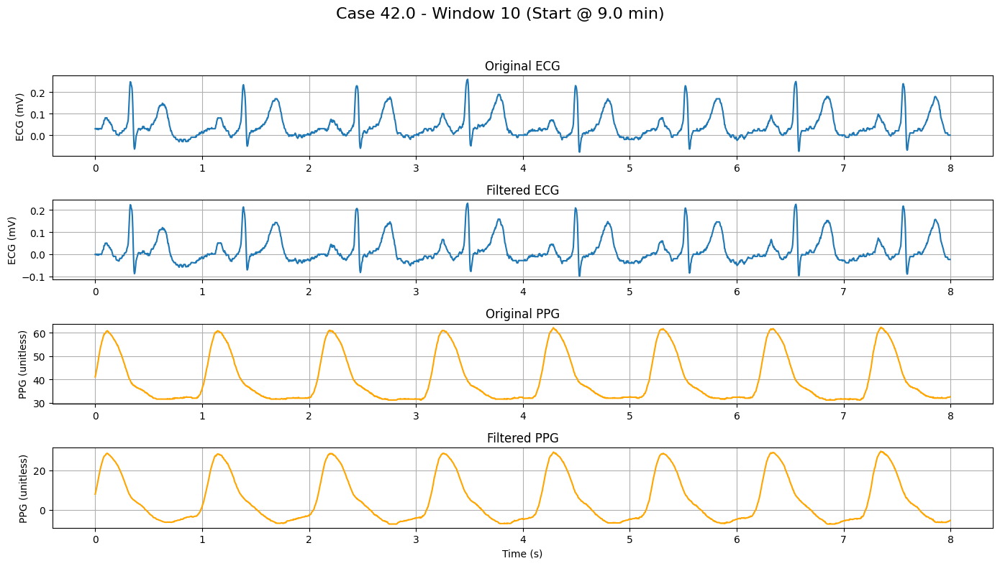


🩺 Processing Case 8.0...


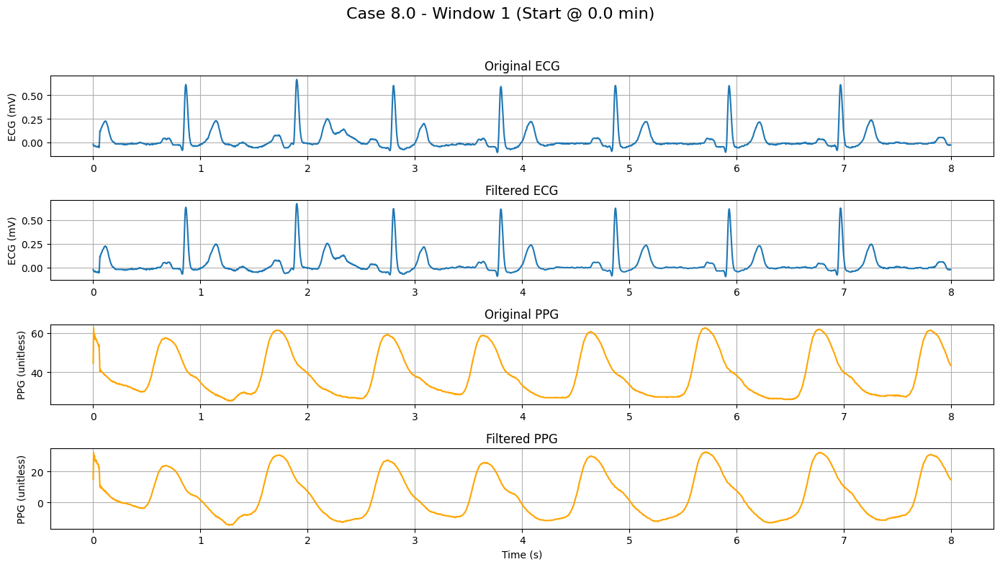

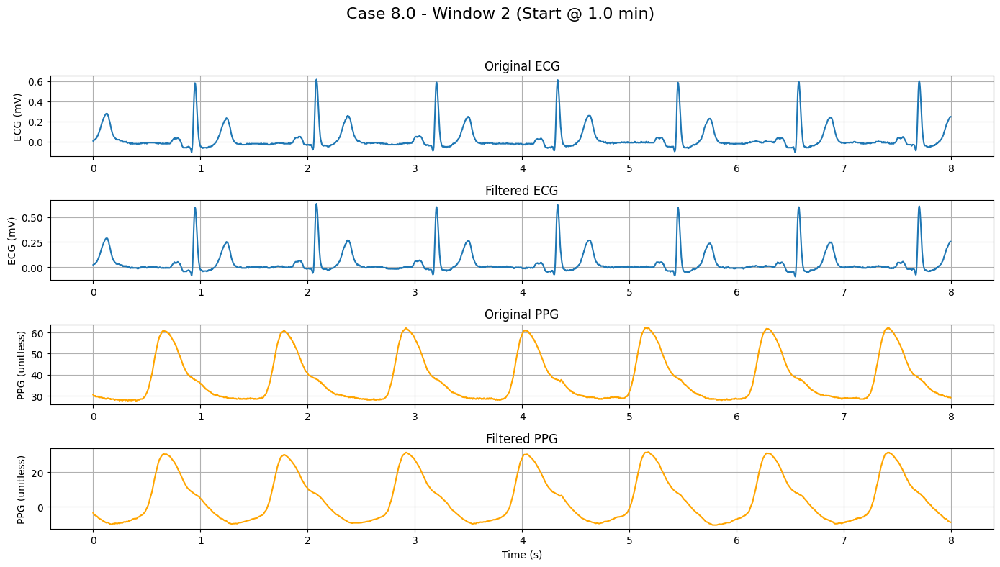

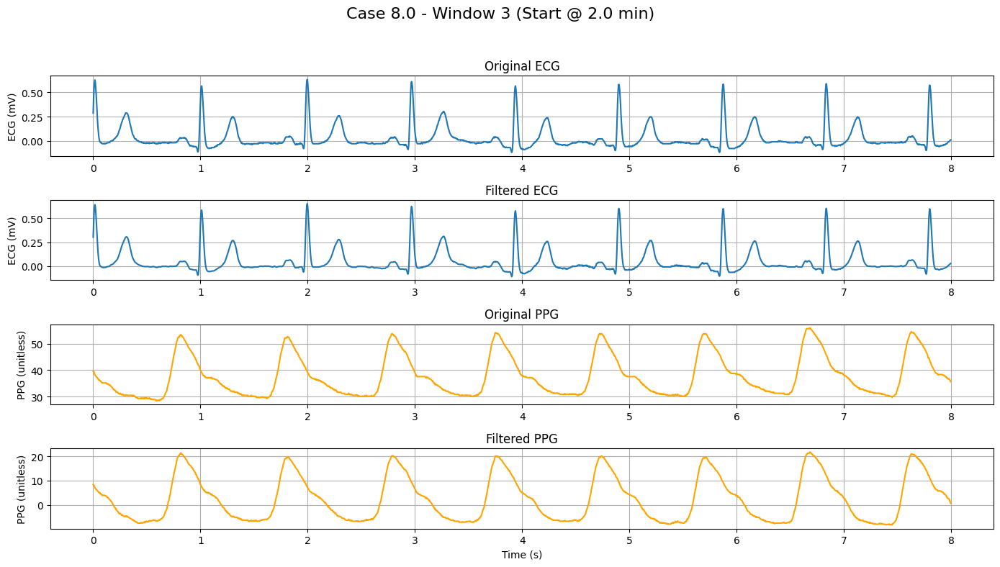

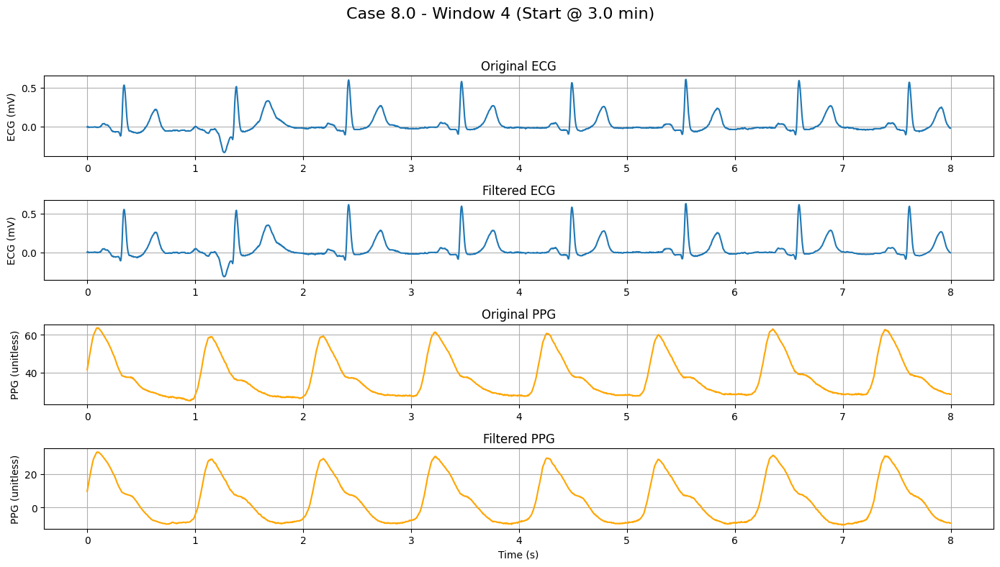

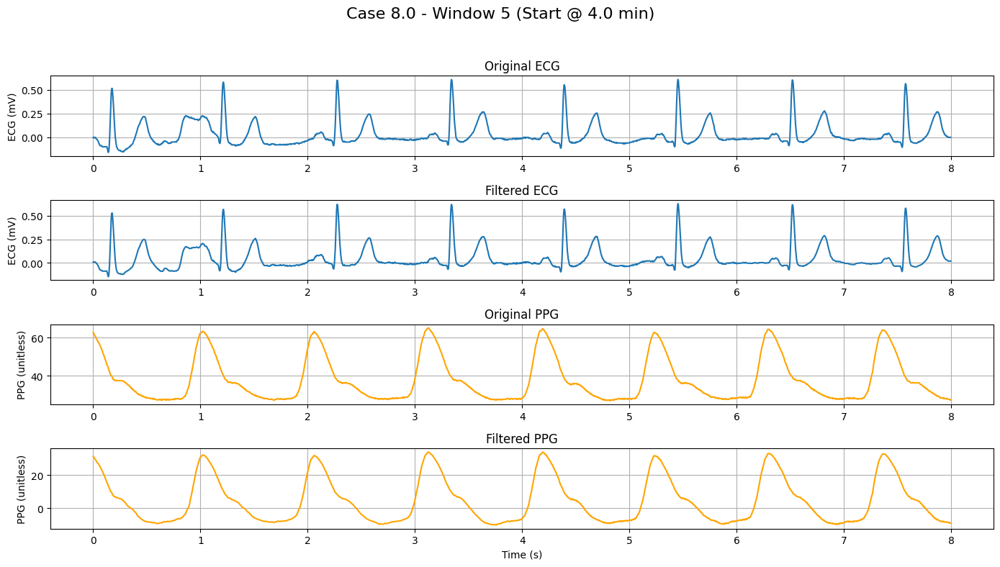

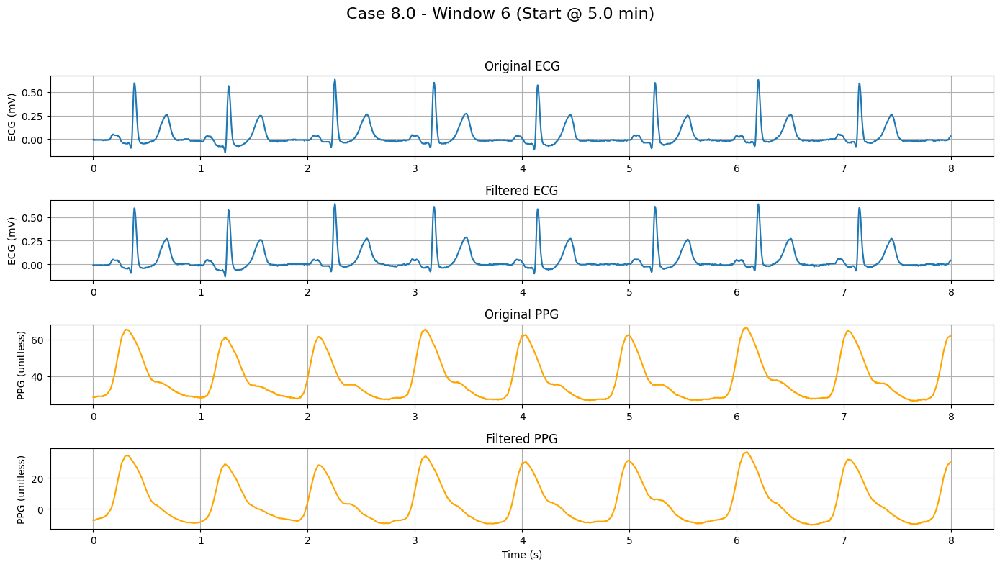

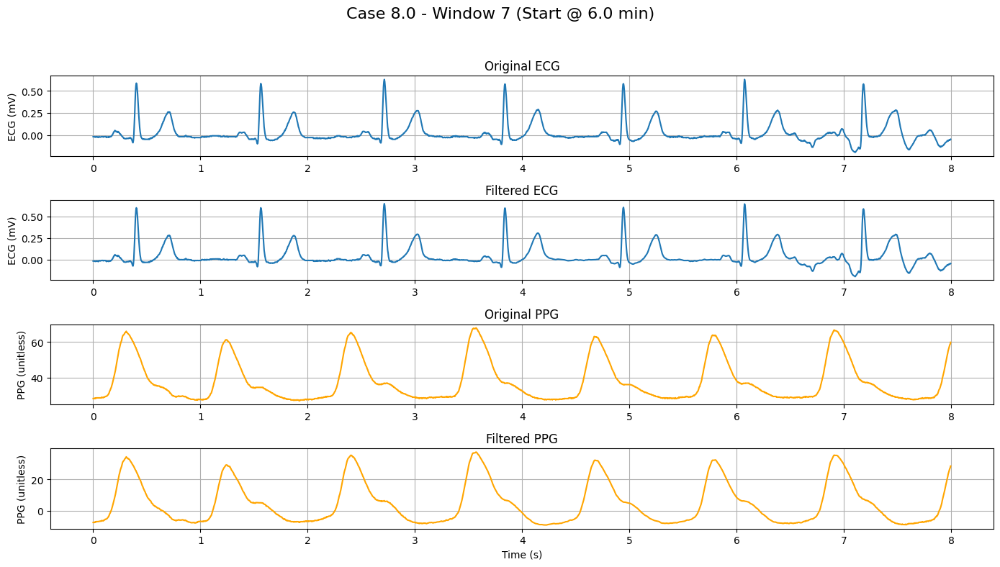

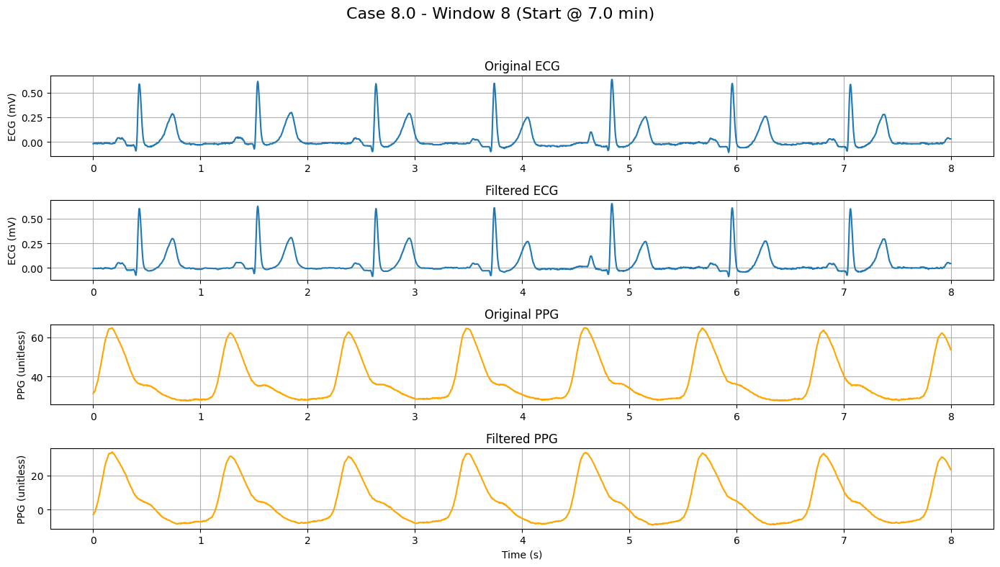

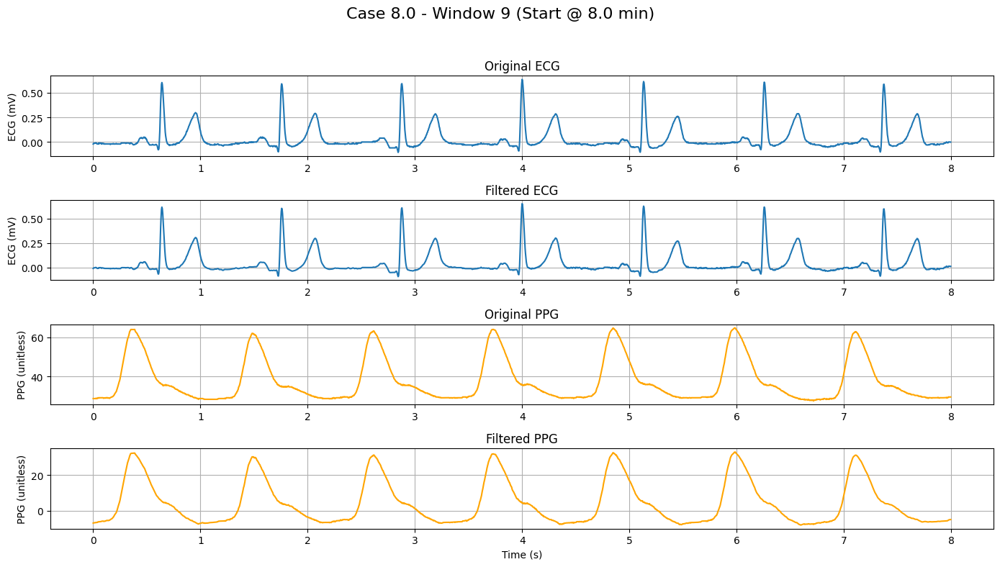

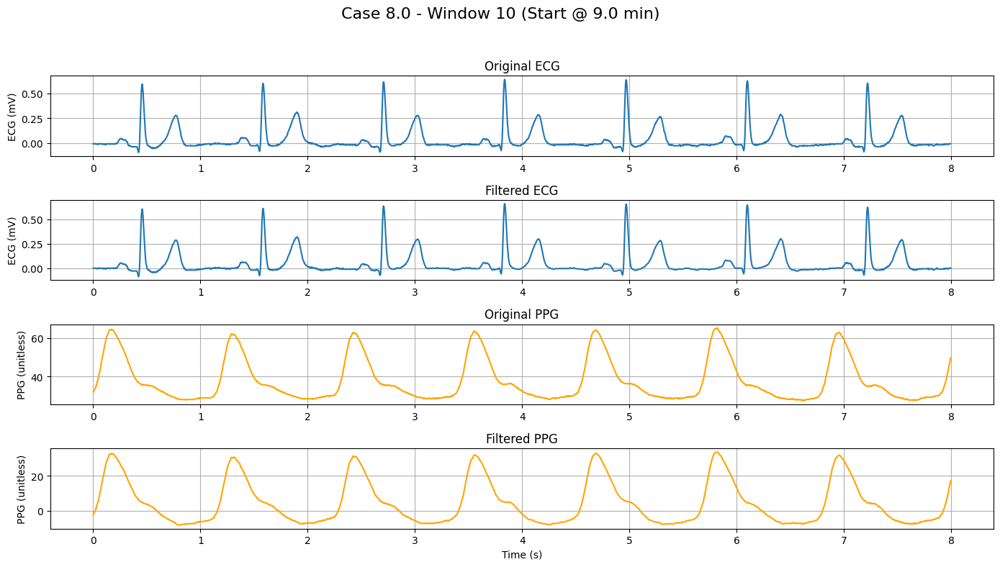


🩺 Processing Case 37.0...


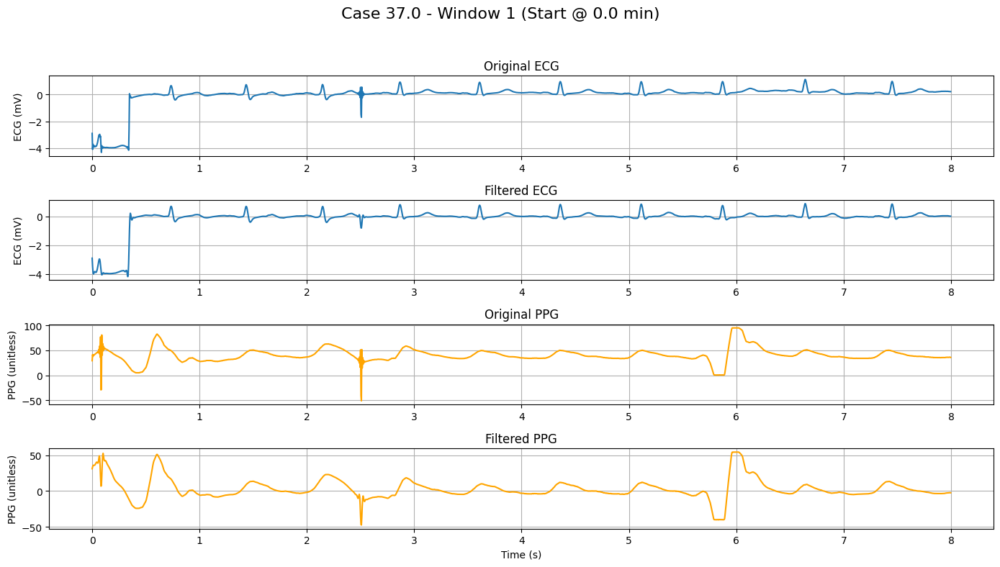

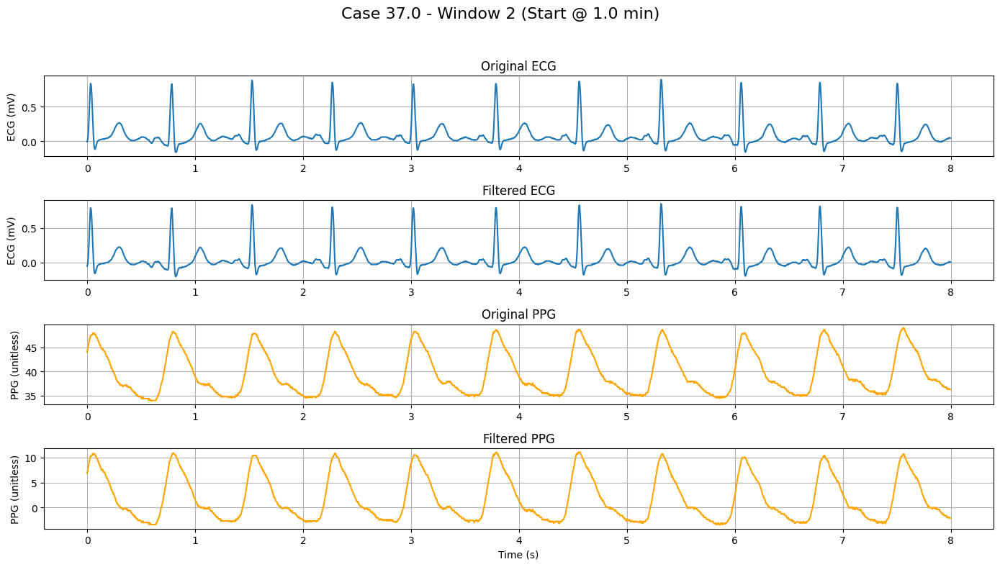

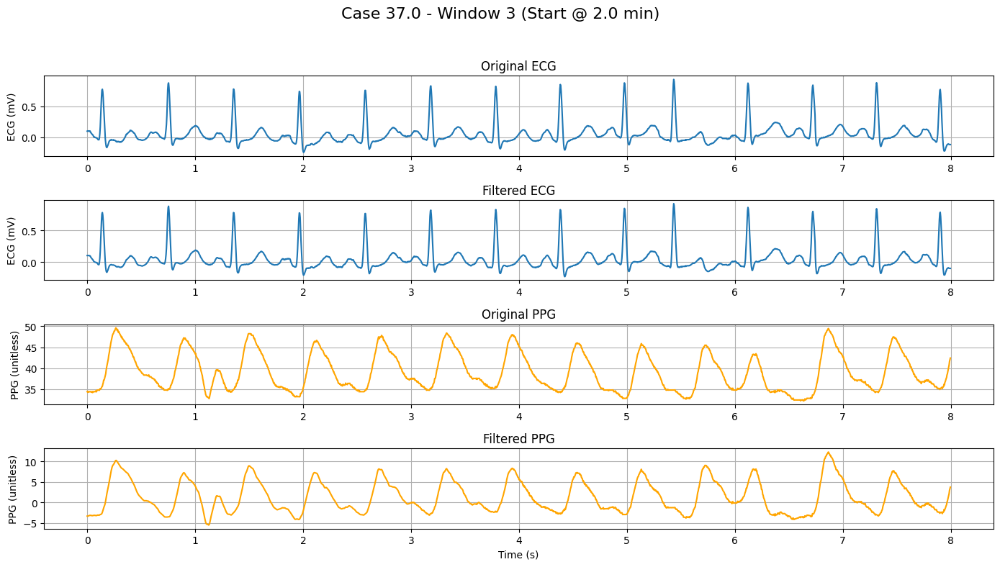

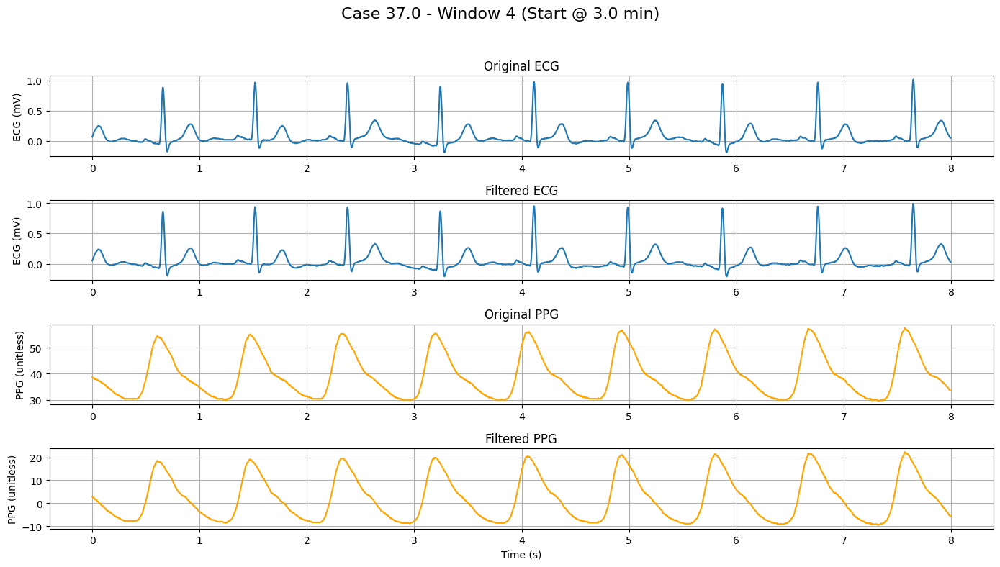

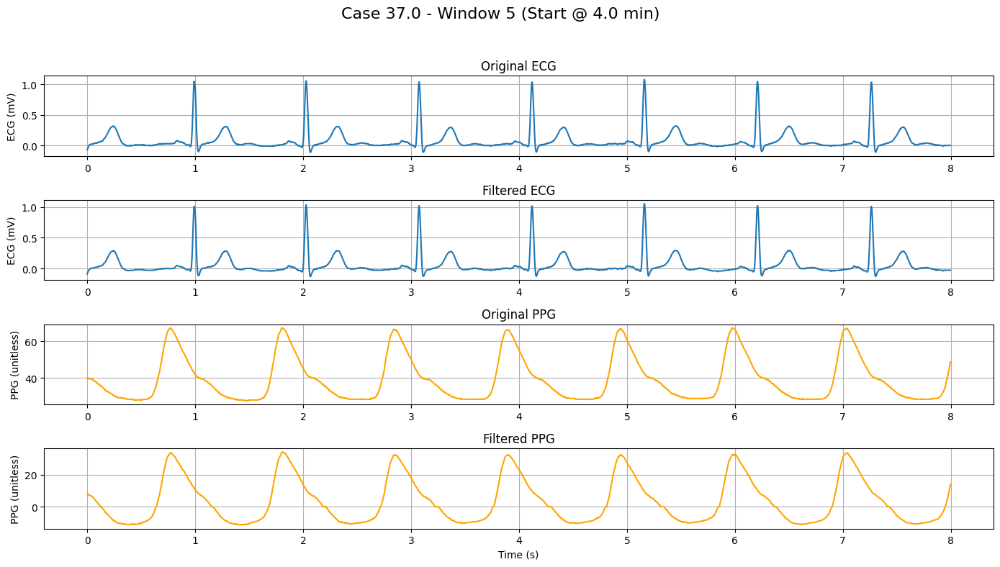

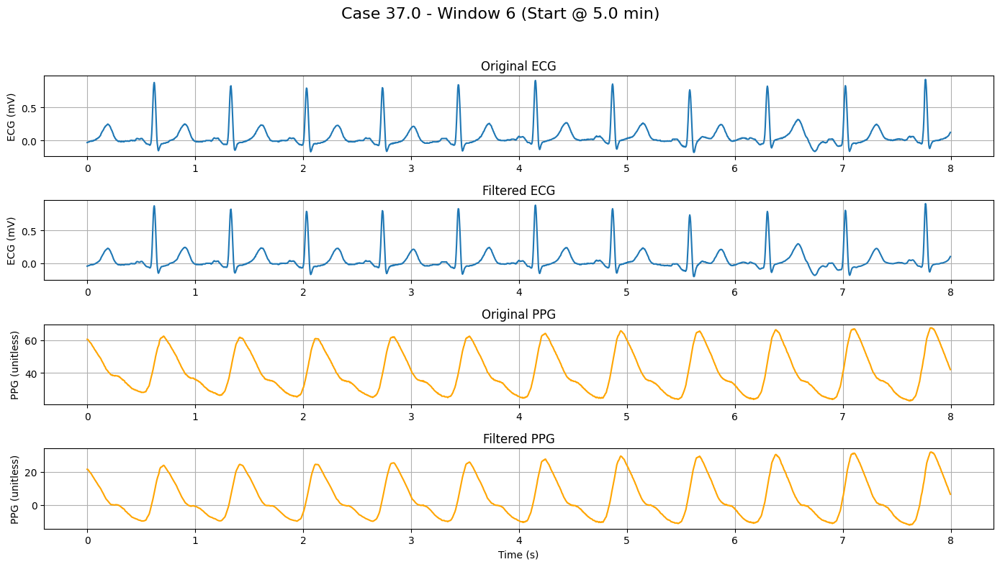

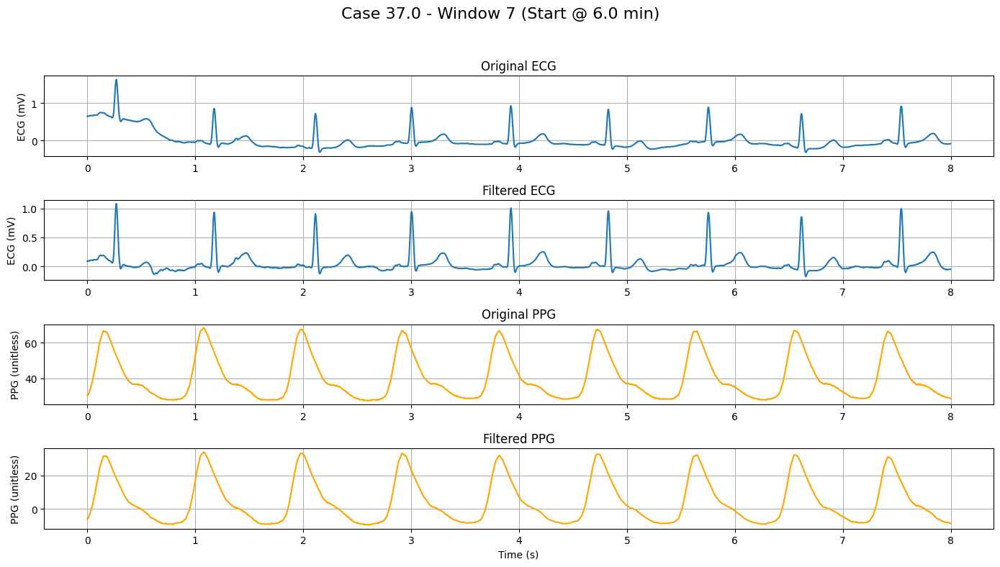

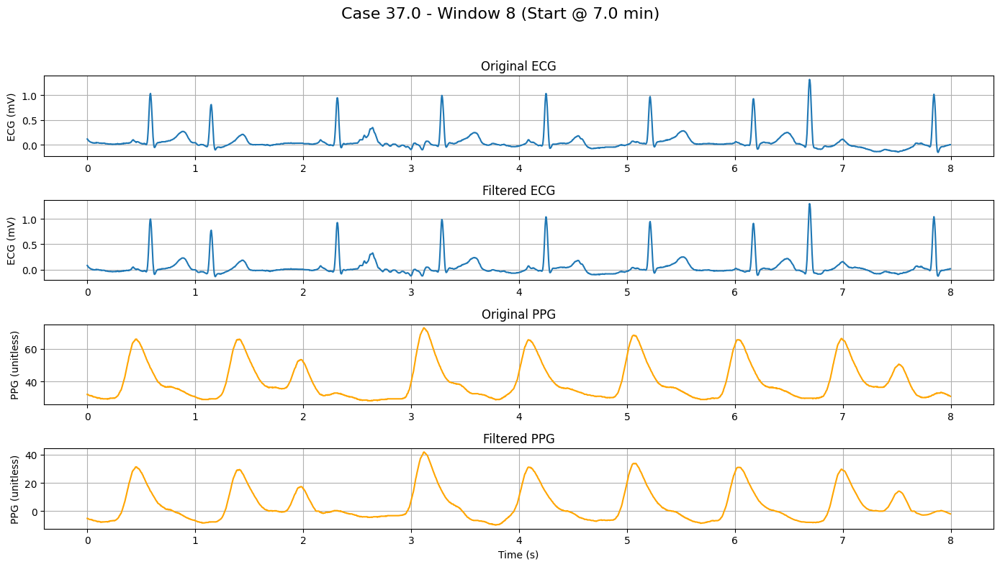

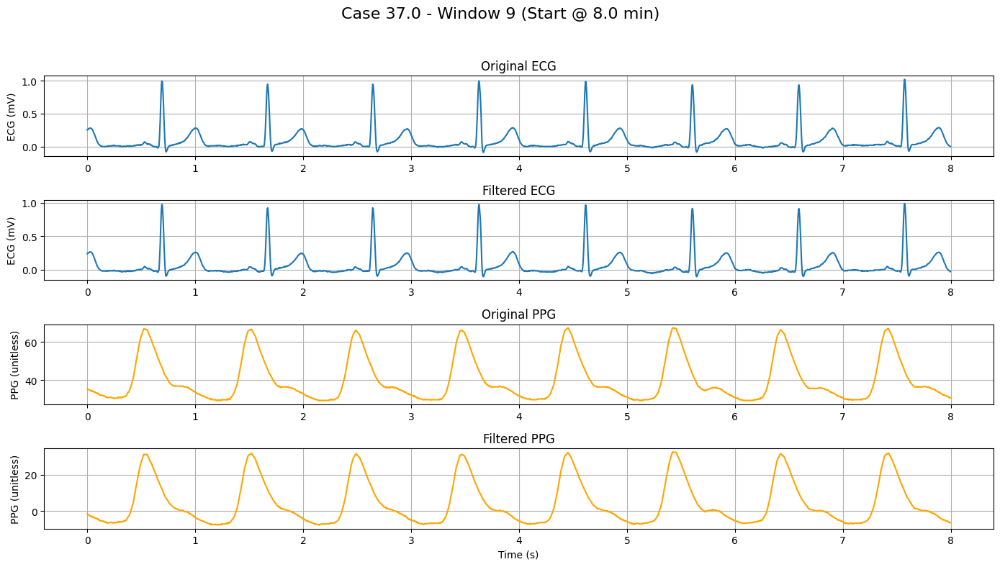

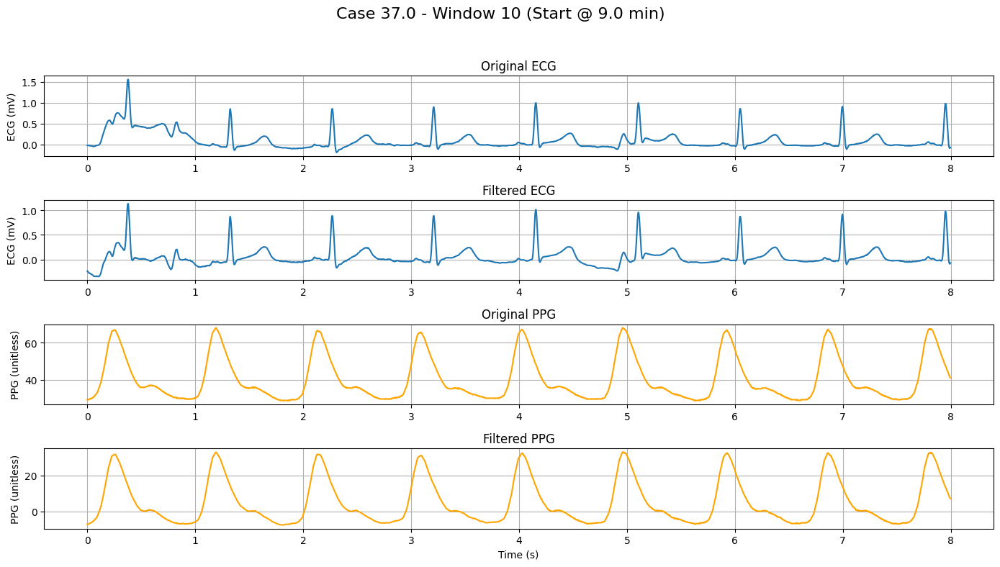


🩺 Processing Case 2.0...


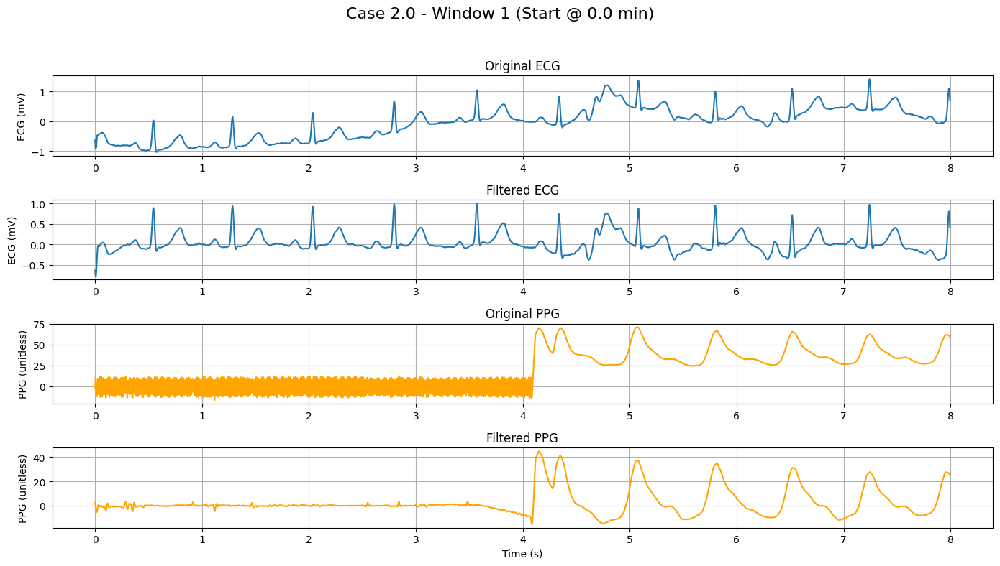

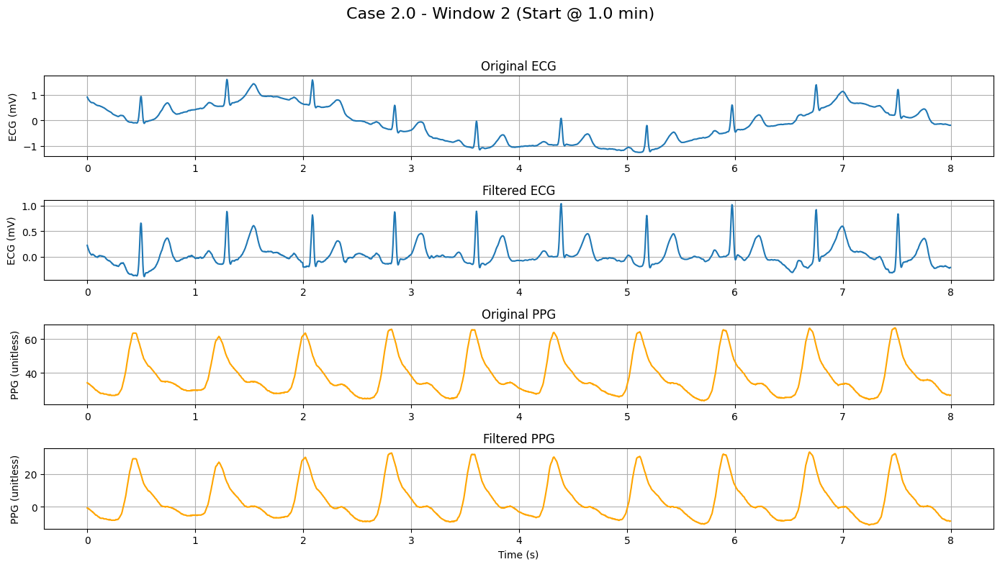

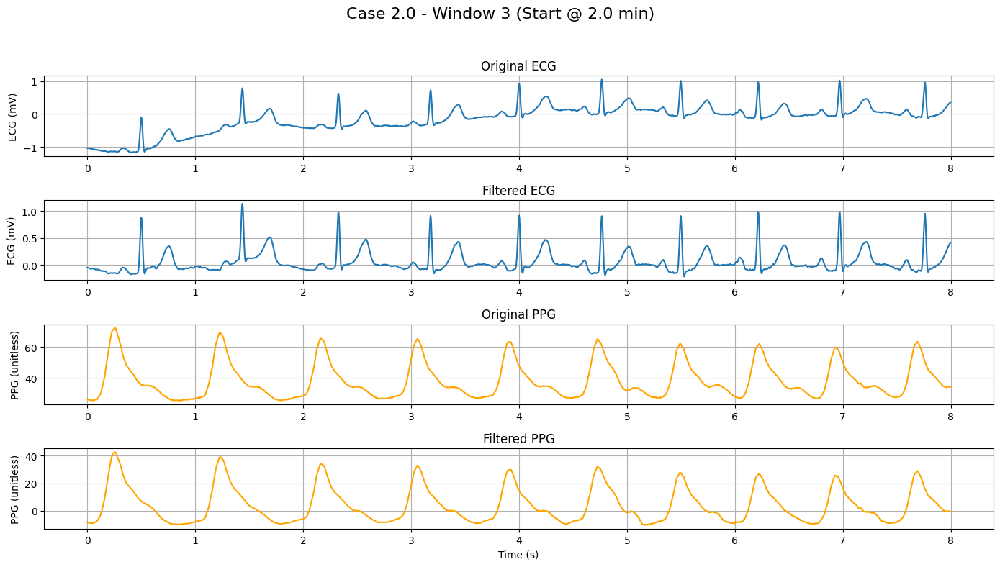

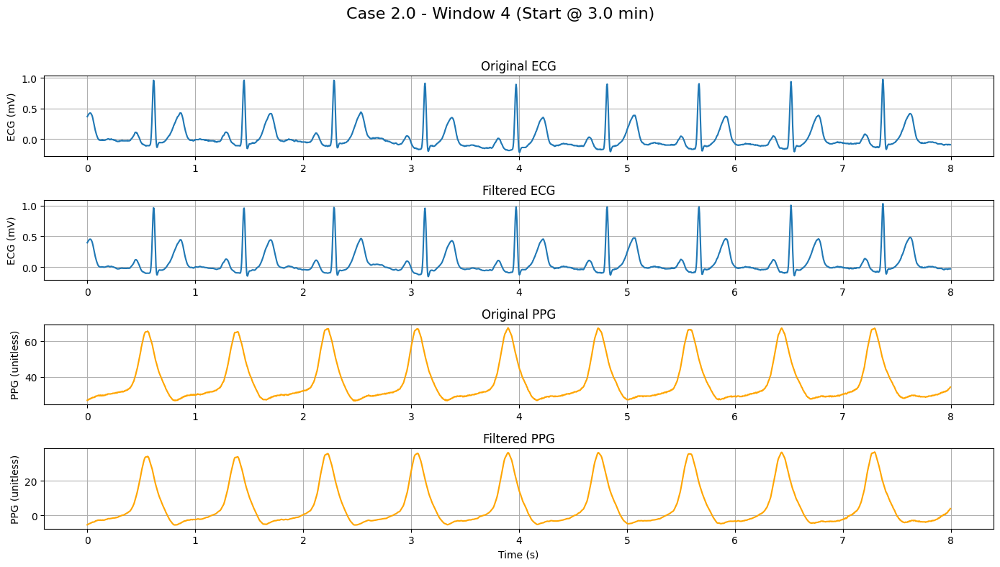

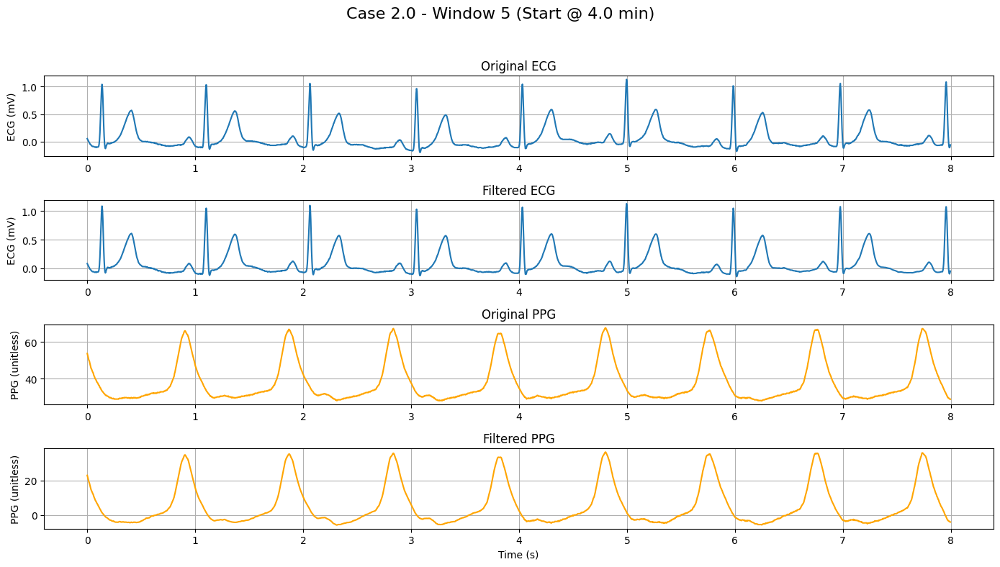

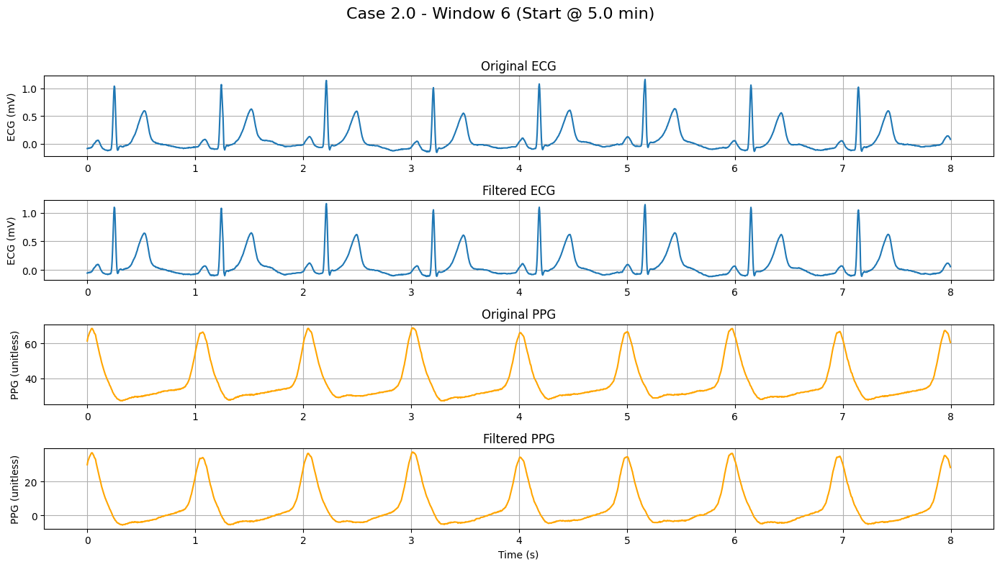

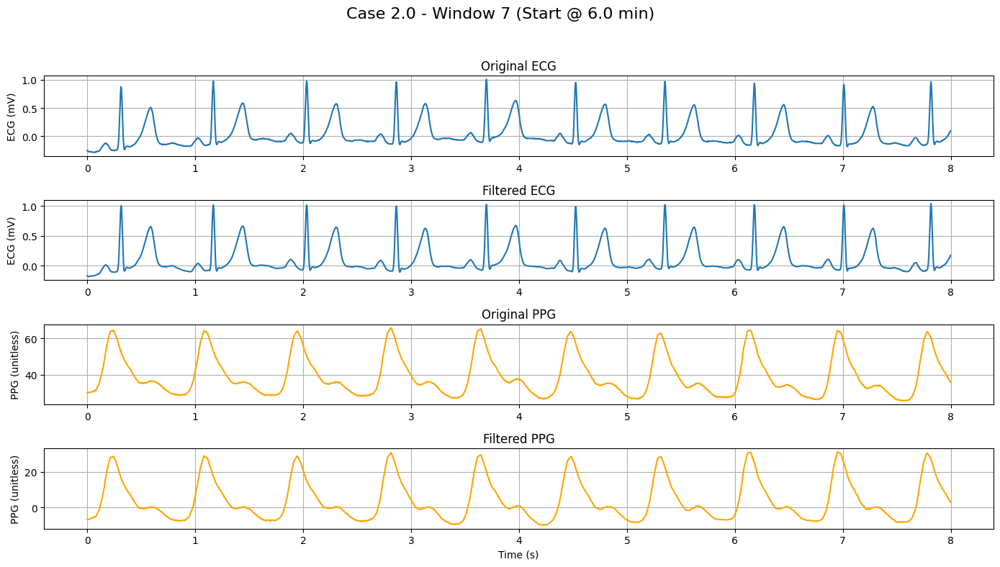

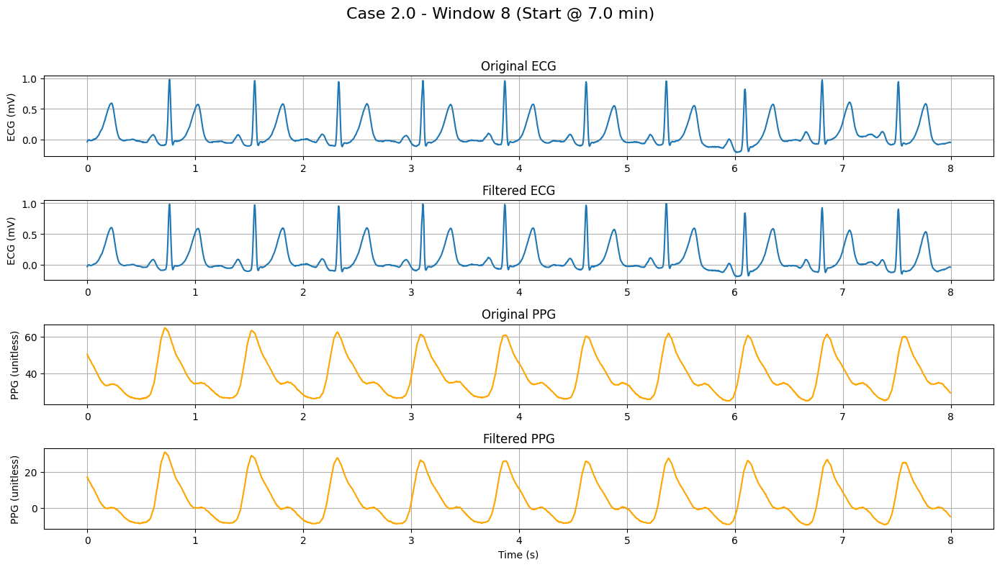

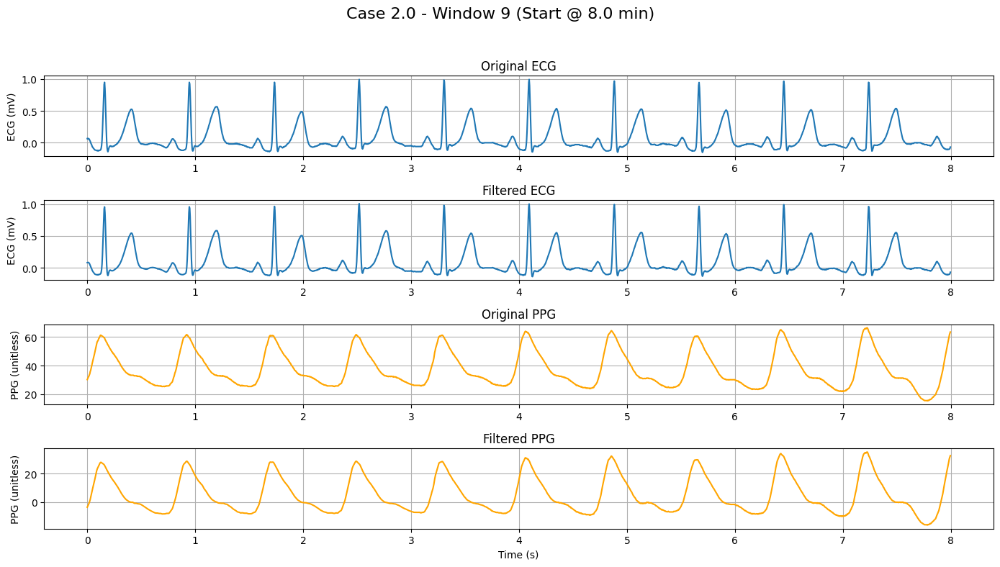

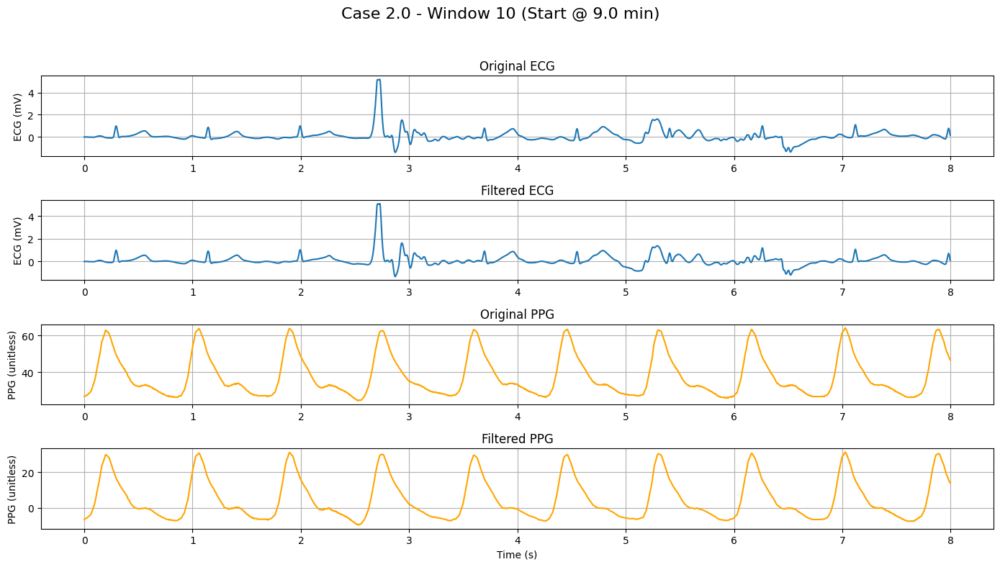


🩺 Processing Case 35.0...


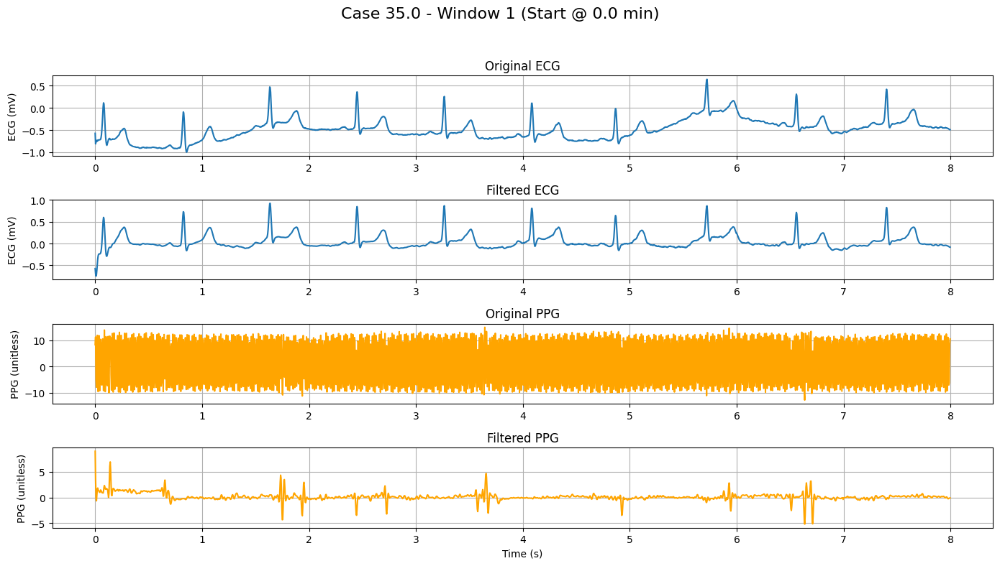

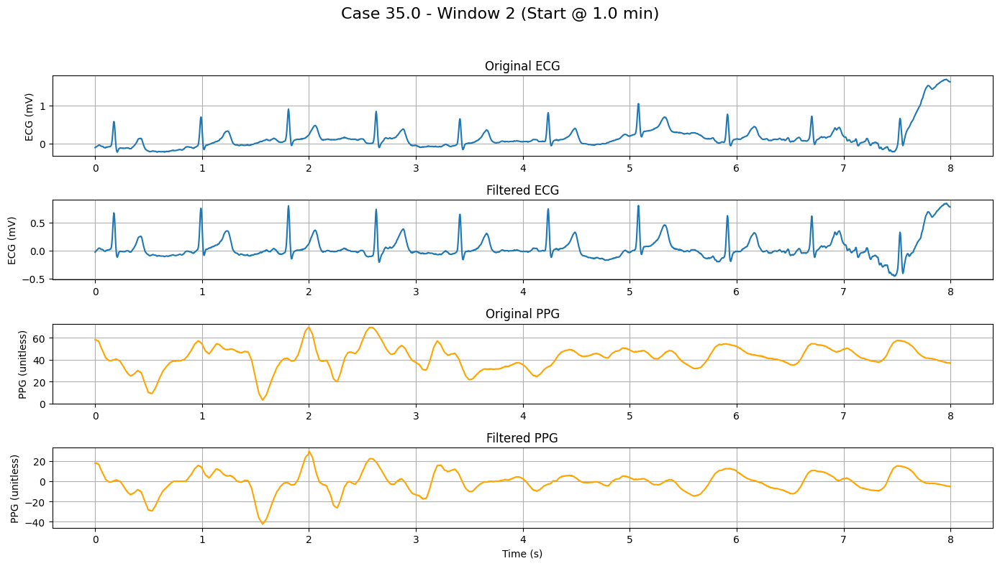

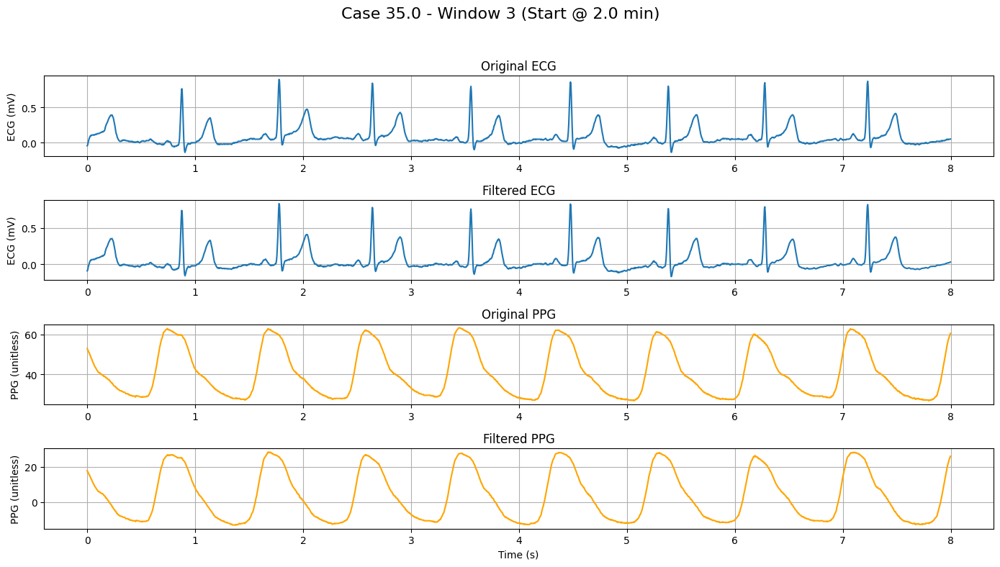

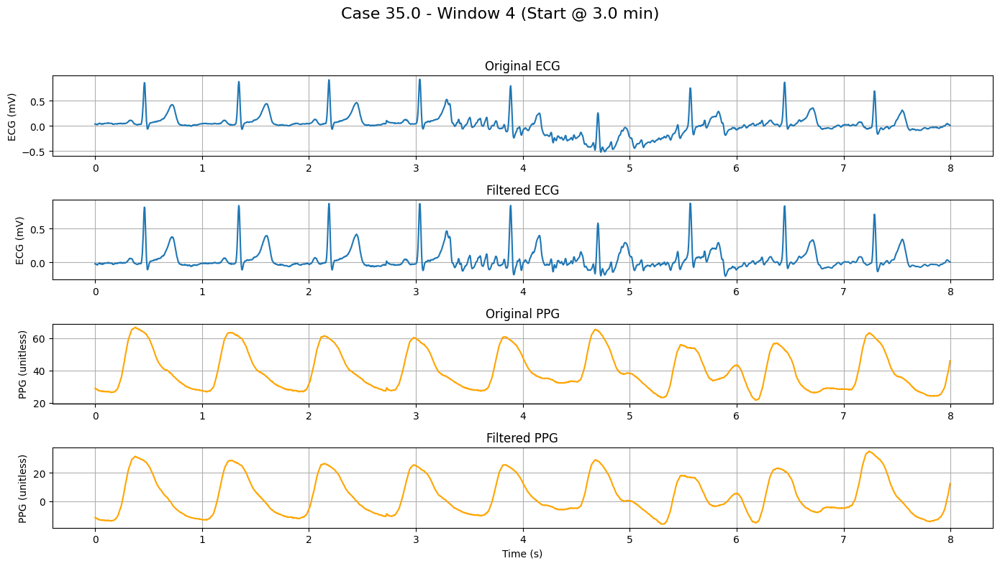

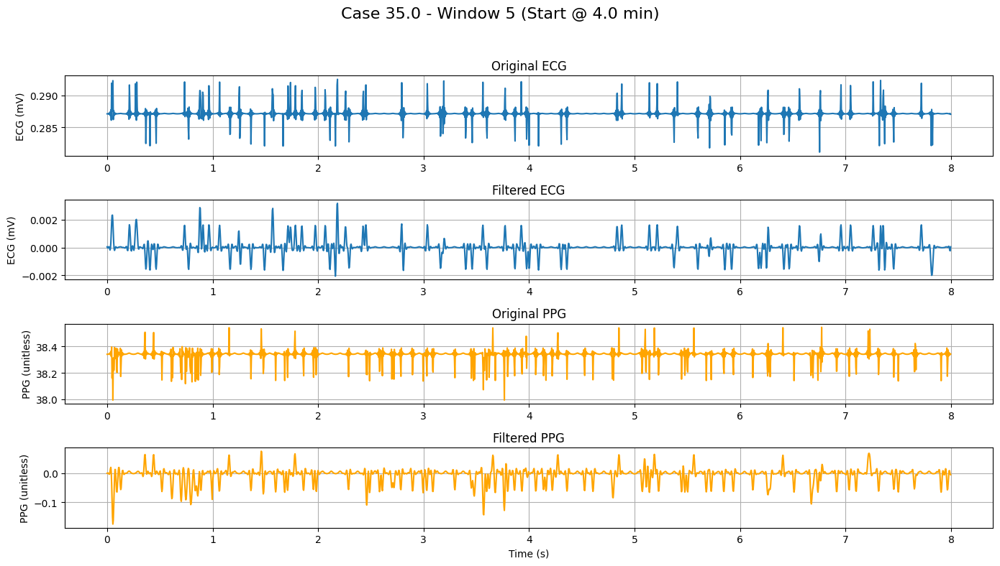

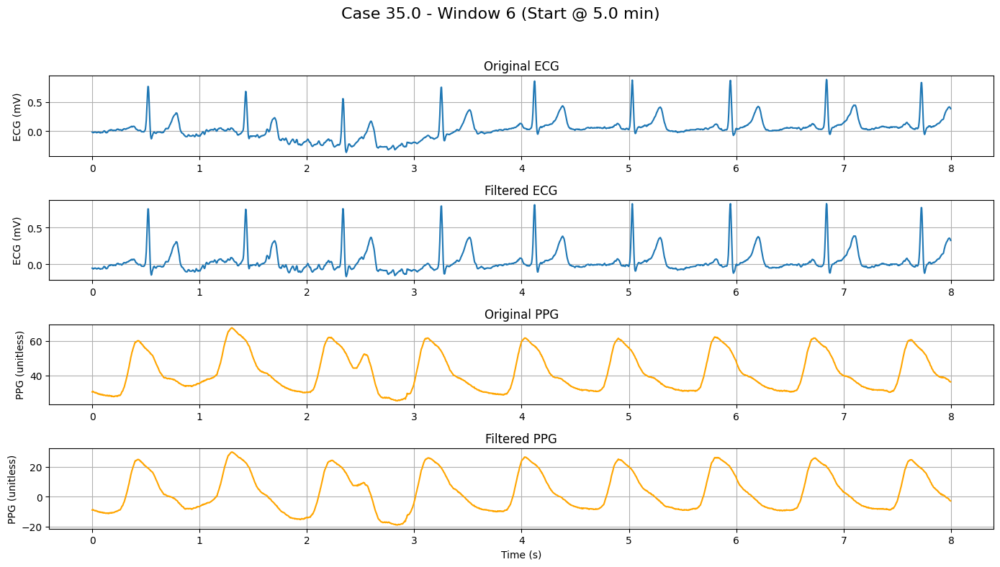

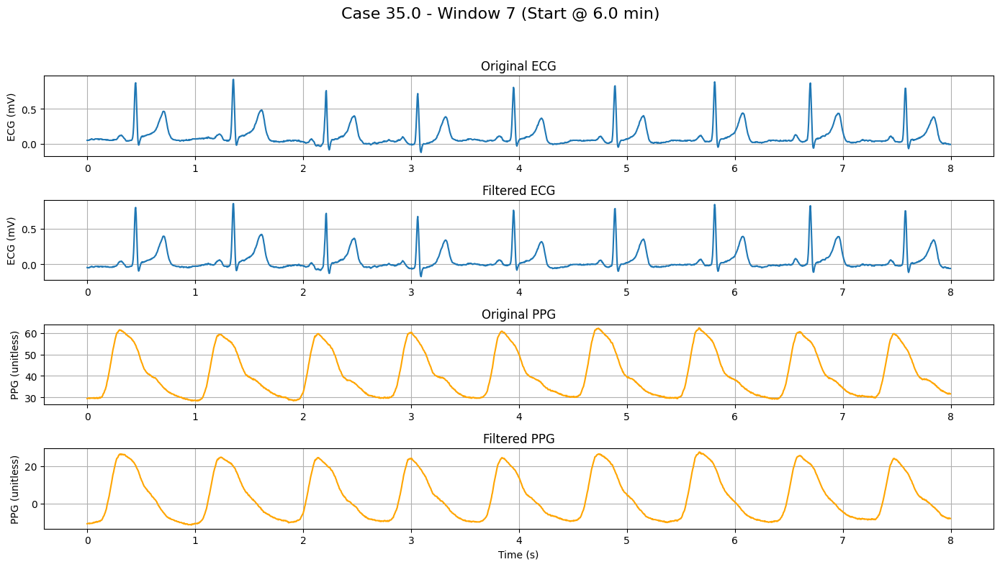

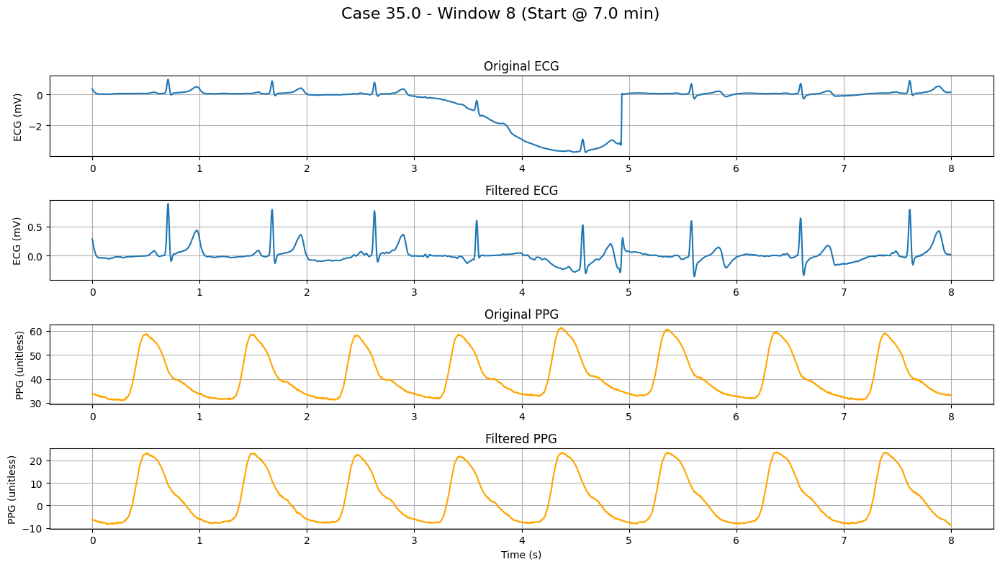

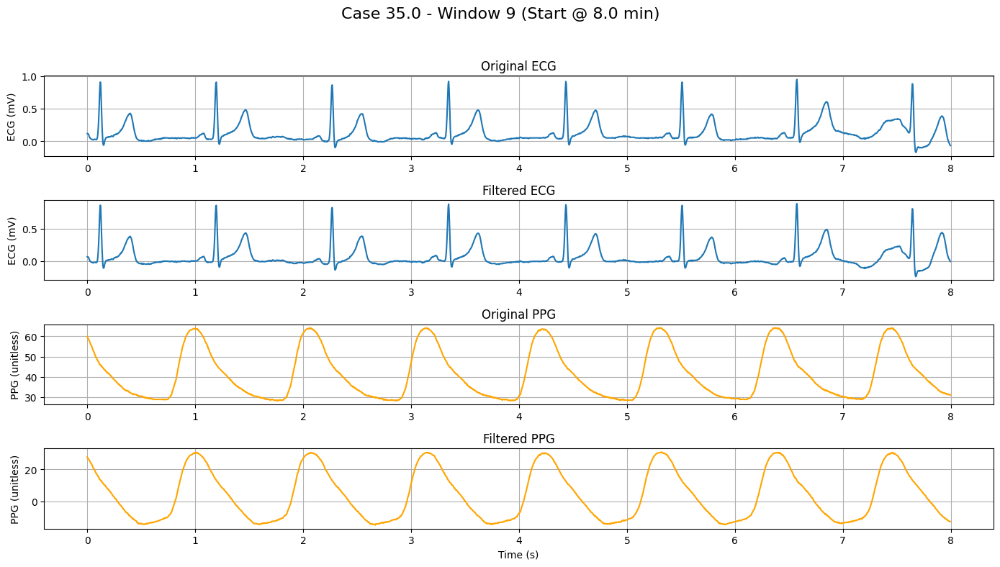

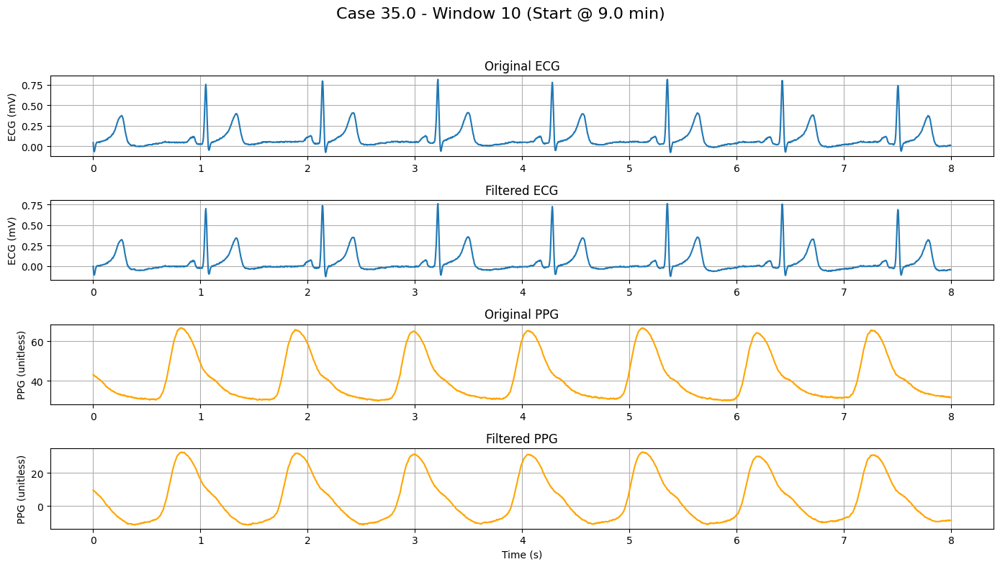

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import resample_poly

# --- Use adaptive_denoise_signal and other helpers already defined ---

target_fs = 256
window_sec = 8
stride_sec = 60
max_cases = 10
segment_duration_min = 10

print(f"\n🚑 Plotting 8-second windows every 60 seconds (10 windows) for the first {max_cases} cases...")

for idx in range(min(max_cases, len(df_results))):
    cid = df_results.iloc[idx]['CaseID']
    print(f"\n🩺 Processing Case {cid}...")

    try:
        # Load signals
        vals = vitaldb.load_case(cid, ['ECG_II', 'PLETH'], 1/fs)
        ecg = vals[:, 0]
        ppg = vals[:, 1]
        valid = ~np.isnan(ecg) & ~np.isnan(ppg)
        ecg = ecg[valid]
        ppg = ppg[valid]

        # Downsample to 256 Hz if needed
        if fs != target_fs:
            ecg = resample_poly(ecg, target_fs, fs)
            ppg = resample_poly(ppg, target_fs, fs)
            effective_fs = target_fs
        else:
            effective_fs = fs

        # Skip cases shorter than segment_duration_min
        min_samples = segment_duration_min * 60 * effective_fs
        if len(ecg) < min_samples:
            print(f"⚠️ Case {cid} skipped: too short ({len(ecg)/effective_fs:.1f} sec).")
            continue

        # Choose a 10-minute segment (for simplicity, we’ll just pick a segment near the start)
        start_segment = 0  # adjust logic if you want a different placement
        end_segment = start_segment + min_samples
        if end_segment > len(ecg):
            start_segment = len(ecg) - min_samples
            end_segment = len(ecg)

        ecg_segment = ecg[start_segment:end_segment]
        ppg_segment = ppg[start_segment:end_segment]

        # Apply adaptive denoising
        ecg_denoised = adaptive_denoise_signal(ecg_segment, effective_fs)
        ppg_denoised = adaptive_denoise_signal(ppg_segment, effective_fs)

        # Plot windows
        window_samples = int(window_sec * effective_fs)
        stride_samples = int(stride_sec * effective_fs)

        for i in range(10):  # exactly 10 windows
            start = i * stride_samples
            end = start + window_samples
            if end > len(ecg_segment):
                break  # skip incomplete windows at end

            t = np.arange(window_samples) / effective_fs

            fig, axs = plt.subplots(4, 1, figsize=(14, 8))
            fig.suptitle(f"Case {cid} - Window {i+1} (Start @ {start/effective_fs/60:.1f} min)", fontsize=16)

            axs[0].plot(t, ecg_segment[start:end])
            axs[0].set_ylabel("ECG (mV)")
            axs[0].set_title("Original ECG")
            axs[0].grid()

            axs[1].plot(t, ecg_denoised[start:end])
            axs[1].set_ylabel("ECG (mV)")
            axs[1].set_title("Filtered ECG")
            axs[1].grid()

            axs[2].plot(t, ppg_segment[start:end], color='orange')
            axs[2].set_ylabel("PPG (unitless)")
            axs[2].set_title("Original PPG")
            axs[2].grid()

            axs[3].plot(t, ppg_denoised[start:end], color='orange')
            axs[3].set_ylabel("PPG (unitless)")
            axs[3].set_title("Filtered PPG")
            axs[3].set_xlabel("Time (s)")
            axs[3].grid()

            plt.tight_layout(rect=[0, 0, 1, 0.95])
            plt.show()

    except Exception as e:
        print(f"⚠️ Case {cid} skipped during plotting: {e}")
